# load packages

In [1]:
# scanpy packages 
import scanpy as sc
import scanpy.external as sce
import anndata as anndata
import diffxpy.api as de
from anndata import AnnData

# other packages
import time
import os
import numpy as np
import seaborn as sns
import pandas as pd
import re
import h5py
import scipy

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.patches as patches
import matplotlib.colors as colors
import matplotlib.font_manager
%matplotlib inline


# other packages
import glob
from collections import OrderedDict
from scipy.sparse import csr_matrix
import diffxpy.api as de
from scanpy.external.pp import magic
from scipy.stats import zscore
import scipy.cluster.hierarchy as hc
from statistics import median
import math
from typing import Union
import phenograph


#functions
def randomize_cells(anndata_object):
    "Randomize cells for plotting UMAP"
    index_list = np.arange(anndata_object.shape[0])
    np.random.shuffle(index_list)
    anndata_object = anndata_object[index_list]
    return anndata_object

# to remove nan from dict
def sqlargs(kargs: dict, val: Union[str, int] = "NULL") -> dict:
    """\
    A cleaner for `nan` data types of empty values in dictionary.
    :param kargs:
        Dirty dictionary
    :param val: 
        Replacement value
    :return:
        Clean dictionary
    """
    for k, v in kargs.items():
        if isinstance(v, dict):
            sqlargs(v)
        else:
            kargs[k] = [v for v in kargs[k] if not (isinstance(v, float) and math.isnan(v))]
    return kargs

import numpy.matlib

from kneed import KneeLocator


In [2]:
import pkg_resources
import types
def get_imports():
    for name, val in globals().items():
        if isinstance(val, types.ModuleType):
            # Split ensures you get root package, 
            # not just imported function
            name = val.__name__.split(".")[0]

        elif isinstance(val, type):
            name = val.__module__.split(".")[0]

        # Some packages are weird and have different
        # imported names vs. system/pip names. Unfortunately,
        # there is no systematic way to get pip names from
        # a package's imported name. You'll have to had
        # exceptions to this list manually!
        poorly_named_packages = {
            "PIL": "Pillow",
            "sklearn": "scikit-learn"
        }
        if name in poorly_named_packages.keys():
            name = poorly_named_packages[name]

        yield name
imports = list(set(get_imports()))

# The only way I found to get the version of the root package
# from only the name of the package is to cross-check the names 
# of installed packages vs. imported packages
requirements = []
for m in pkg_resources.working_set:
    if m.project_name in imports and m.project_name!="pip":
        requirements.append((m.project_name, m.version))
        
        
# Count distribution
def total_molecules_per_cell(adat, count=str):

    # Plot distribution of total molecules per cell
    a = adat.copy()

    print("Median total count of UMI is:", np.median(a.obs[count]))

    # Per cell (Total molecules per cell)
    fig, (ax1, ax2, ax3) = plt.subplots(nrows=3,
                                        ncols=1,
                                        sharex=True,
                                        figsize=(15, 5))

    a.obs[count][a.obs[count] != 0].plot(kind="hist",
                                         bins=100,
                                         ax=ax1,
                                         color="r")
    a.obs[count][a.obs[count] != 0].plot(kind="kde", ax=ax2, color="r")
    a.obs[count][a.obs[count] != 0].plot(kind="box",
                                         vert=False,
                                         ax=ax3,
                                         color="r")

    x = ax3.set_xlabel("Molecule counts "+ count +" per cell")

    return None


for r in requirements:
    print("{}=={}".format(*r))

seaborn==0.11.1
scipy==1.6.1
scanpy==1.7.1
pandas==1.0.3
numpy==1.18.5
matplotlib==3.1.3
magic==0.1.1
kneed==0.7.0
h5py==2.10.0
diffxpy==0.7.4
anndata==0.7.5


In [3]:
#get additional packages of interest
import pkg_resources
# list packages to be checked
root_packages = ['magic']
# print versions, but check if package is imported first
for m in pkg_resources.working_set:
    if m.project_name.lower() in root_packages:
        print(f"{m.project_name}=={m.version}")

magic==0.1.1


In [4]:
#set style
sns.set_style('white')
# define colors
color_map_clusters = ["#FFFF00", "#1CE6FF", "#FF34FF", "#FF4A46", "#008941", "#006FA6", "#A30059",
"#FFDBE5", "#7A4900", "#0000A6", "#63FFAC", "#B79762", "#004D43", "#8FB0FF", "#997D87",
"#5A0007", "#809693", "#1B4400", "#4FC601", "#3B5DFF", "#4A3B53", "#FF2F80",
"#61615A", "#BA0900", "#6B7900", "#00C2A0", "#FFAA92", "#FF90C9", "#B903AA", "#D16100",
"#DDEFFF", "#000035", "#7B4F4B", "#A1C299", "#300018", "#0AA6D8", "#013349", "#00846F",
"#372101", "#FFB500", "#C2FFED", "#A079BF", "#CC0744", "#C0B9B2", "#C2FF99", "#001E09",
"#00489C", "#6F0062", "#0CBD66", "#EEC3FF", "#456D75", "#B77B68", "#7A87A1", "#788D66",
"#885578", "#FAD09F", "#FF8A9A", "#D157A0", "#BEC459", "#456648", "#0086ED", "#886F4C",
"#34362D", "#B4A8BD", "#00A6AA", "#452C2C", "#636375", "#A3C8C9", "#FF913F", "#938A81",
"#575329", "#00FECF", "#B05B6F", "#8CD0FF", "#3B9700", "#04F757", "#C8A1A1", "#1E6E00",
"#7900D7", "#A77500", "#6367A9", "#A05837", "#6B002C", "#772600", "#D790FF", "#9B9700",
"#549E79", "#FFF69F", "#201625", "#72418F", "#BC23FF", "#99ADC0", "#3A2465", "#922329",
"#5B4534", "#FDE8DC", "#404E55", "#0089A3", "#CB7E98", "#A4E804", "#324E72", "#6A3A4C"]

color_map_clusters_nogrey = ["#FFFF00", "#1CE6FF", "#FF34FF", "#FF4A46", "#008941", "#006FA6", "#A30059", "#7A4900", "#0000A6", "#63FFAC", "#B79762", "#004D43", "#8FB0FF", "#997D87",
"#5A0007", "#809693", "#1B4400", "#4FC601", "#3B5DFF", "#4A3B53", "#FF2F80",
"#61615A", "#BA0900", "#6B7900", "#00C2A0", "#FFAA92", "#FF90C9", "#B903AA", "#D16100",
"#DDEFFF", "#000035", "#7B4F4B", "#A1C299", "#300018", "#0AA6D8", "#013349", "#00846F",
"#372101", "#FFB500", "#C2FFED", "#A079BF", "#CC0744", "#C0B9B2", "#C2FF99", "#001E09",
"#00489C", "#6F0062", "#0CBD66", "#EEC3FF", "#456D75", "#B77B68", "#7A87A1", "#788D66",
"#885578", "#FAD09F", "#FF8A9A", "#D157A0", "#BEC459", "#456648", "#0086ED", "#886F4C",
"#34362D", "#B4A8BD", "#00A6AA", "#452C2C", "#636375", "#A3C8C9", "#FF913F", "#938A81",
"#575329", "#00FECF", "#B05B6F", "#8CD0FF", "#3B9700", "#04F757", "#C8A1A1", "#1E6E00",
"#7900D7", "#A77500", "#6367A9", "#A05837", "#6B002C", "#772600", "#D790FF", "#9B9700",
"#549E79", "#FFF69F", "#201625", "#72418F", "#BC23FF", "#99ADC0", "#3A2465", "#922329",
"#5B4534", "#FDE8DC", "#404E55", "#0089A3", "#CB7E98", "#A4E804", "#324E72", "#6A3A4C"]

perturbation_map = ['#EFD060','#0289DE','#0289DE','#DCA6C4']
stage_map = ['#EFD060','#0289DE','#67C6F8','#DCA6C4']
stage_map_2 = ['#EFD060','#0289DE','#DCA6C4']
blue_red = ['#0E518F','#DF480F']
perturbation_stage_map_2 = ['#F95957', '#FF0300','#EFD060','#0289DE','#0289DE','#DCA6C4','#EFD060','#0289DE','#DCA6C4']
perturbation_stage_map = ['#F95957', '#FF0300','#e1e1e1','#e1e1e1','#e1e1e1','#e1e1e1', '#EFD060','#0289DE','#DCA6C4']
color_map_clusters_plt = cm = LinearSegmentedColormap.from_list(
        'color_map_clusters', color_map_clusters)

#scanpy layout
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=80, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=True, ipython_format='png2x')
sns.set_style('white')

In [5]:
#run this notebook with every immune cell subset 'TNK', 'B', 'M' individually

# attach obs and .raw element to scran normalized subset data

## load data

In [ ]:
adata_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_TNK_scran.h5ad'
adata_raw_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data_annotated_emptydrops_noribo_nomito_clustered_nodrops_doublets_nodoubs_libsize_log1p_clustered_10000hv_genes_curated_marker_genes_210216_leukocytes_scran_clustered_annotated_imputed_hvg15000_and_marker_genes_TNK.h5ad' # adata of all TIL containing raw counts 
save_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_TNK_scran_raw_counts.h5ad'

#parameters
save_adata =True

In [ ]:
#load subset files
adata = sc.read(adata_path)
adata_raw = sc.read(adata_raw_path)

### subset raw_adata and store in X element of immune subset data

In [ ]:
adata_raw.obs_names

In [ ]:
adata.obs_names

In [ ]:
adata

In [ ]:
adata_raw

In [ ]:
#add raw counts
adata_raw_subset = adata_raw[adata.obs_names, adata.var_names]
adata_raw_subset

In [ ]:
print(adata_raw_subset.X)

In [ ]:
adata_raw_subset

In [ ]:
adata_raw_subset.obs

In [ ]:
adata

In [ ]:
adata.obs

In [ ]:
#check if indices are the same

print('indices are the same:', list(adata.obs_names)==list(adata_raw_subset.obs_names))

In [ ]:
adata_raw_subset.layers['raw'] = adata_raw_subset.raw[adata_raw_subset.obs_names, adata_raw_subset.var_names].X

In [ ]:
adata.layers['raw'] = adata_raw_subset.layers['raw']

In [ ]:
a = adata.copy()
a.obs['total_counts'] =  np.sum(a.layers['raw'], axis=1)
total_molecules_per_cell(a, 'total_counts')

In [ ]:
if save_adata ==True:
    adata.write(save_path)
    print(save_path)

## attach .obs and cluster

In [6]:
#data paths
adata_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_TNK_scran_raw_counts.h5ad'
adata_obs_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data_annotated_emptydrops_noribo_nomito_clustered_nodrops_doublets_nodoubs_libsize_log1p_clustered_10000hv_genes_curated_marker_genes_210216_leukocytes_scran_clustered_annotated_imputed_hvg15000_and_marker_genes_TNK.h5ad'
#adata with important obs elements
adata_save_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_TNK_scran_raw_counts_annotated_clustered.h5ad'


#obs elements to attach from all TIL data
obs_list = [ 'batch', 'primary_tumor', 'Limited', 'PValue_emptydrops', 'FDR_emptydrops', 
            'total_molecules', 'percent_mito', 'pheno_var_k10', 'pheno_var_k20', 'pheno_var_k30', 
            'pheno_var_k40', 'pheno_var_k50', 'pheno_var_k60', 'pheno_var_k70', 'pheno_var_k80', 
            'pheno_var_k90', 'pheno_var_k100', 'major_subsets']

#clustering parameters 
pheno_names = ['pheno_TNK_k10', 'pheno_TNK_k20', 'pheno_TNK_k30', 'pheno_TNK_k40', 'pheno_TNK_k50', 'pheno_TNK_k60',
              'pheno_TNK_k70','pheno_TNK_k80','pheno_TNK_k90','pheno_TNK_k100']
pheno_k = [10,20,30,40,50,60,70,80,90,100]


In [7]:
adata = sc.read(adata_path)
adata_obs = sc.read(adata_obs_path)

In [8]:
adata

AnnData object with n_obs × n_vars = 20702 × 16108
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    layers: 'raw'

In [9]:
adata_obs

AnnData object with n_obs × n_vars = 20922 × 18119
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'batch', 'primary_tumor', 'Limited', 'PValue_emptydrops', 'FDR_emptydrops', 'total_molecules', 'percent_mito', 'empty_droplet_sig', 'doublets', 'pheno_var_k10', 'pheno_var_k20', 'pheno_var_k30', 'pheno_var_k40', 'pheno_var_k50', 'pheno_var_k60', 'pheno_var_k70', 'pheno_var_k80', 'pheno_var_k90', 'pheno_var_k100', 'major_subsets'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'hvg', 'major_subsets_colors', 'neighbors', 'pca'

In [10]:
#attach important .obs elements from adata_obs to adata

adatas = [adata]
print('attaching obs elements:')

for i in obs_list:
    adatas[0].obs[i] = adata_obs.obs[i].copy()
    print('attached:', i)
    
adatas

attaching obs elements:
attached: batch
attached: primary_tumor
attached: Limited
attached: PValue_emptydrops
attached: FDR_emptydrops
attached: total_molecules
attached: percent_mito
attached: pheno_var_k10
attached: pheno_var_k20
attached: pheno_var_k30
attached: pheno_var_k40
attached: pheno_var_k50
attached: pheno_var_k60
attached: pheno_var_k70
attached: pheno_var_k80
attached: pheno_var_k90
attached: pheno_var_k100
attached: major_subsets


[AnnData object with n_obs × n_vars = 20702 × 16108
     obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'batch', 'primary_tumor', 'Limited', 'PValue_emptydrops', 'FDR_emptydrops', 'total_molecules', 'percent_mito', 'pheno_var_k10', 'pheno_var_k20', 'pheno_var_k30', 'pheno_var_k40', 'pheno_var_k50', 'pheno_var_k60', 'pheno_var_k70', 'pheno_var_k80', 'pheno_var_k90', 'pheno_var_k100', 'major_subsets'
     var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
     layers: 'raw']

## cluster

In [11]:
adatas = [adata]

## PCA neighbors clustering imputation

In [12]:
adata.X

array([[0.       , 0.       , 0.       , ..., 0.       , 0.       ,
        0.       ],
       [0.       , 0.       , 0.       , ..., 0.       , 0.       ,
        0.       ],
       [0.8902812, 0.8902812, 0.       , ..., 0.       , 0.       ,
        0.       ],
       ...,
       [0.       , 0.       , 0.       , ..., 0.       , 0.       ,
        0.       ],
       [0.       , 0.       , 0.       , ..., 0.       , 0.       ,
        0.       ],
       [0.       , 0.       , 0.       , ..., 0.       , 0.       ,
        0.       ]], dtype=float32)

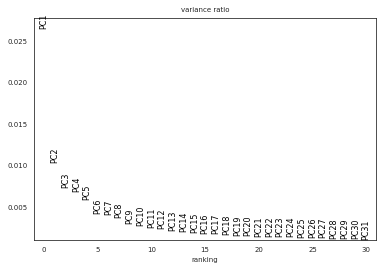

In [13]:
#PCA
%matplotlib inline

sc.tl.pca(adata, svd_solver='arpack',n_comps=100) 
sc.pl.pca_variance_ratio(adata,log=False)

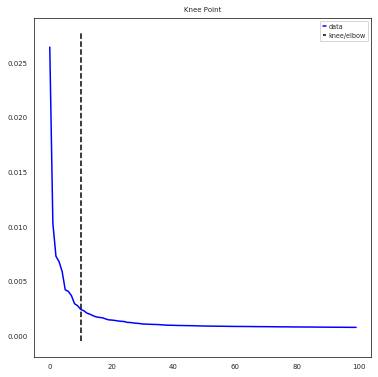

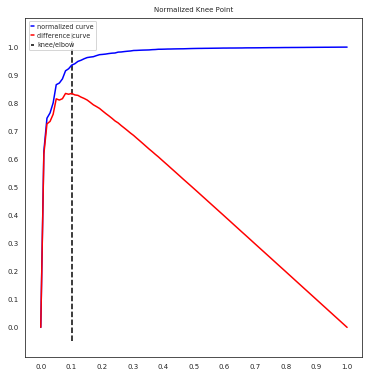

Kneepoint happens at PC: 10
10 PC explain 7.442134479060769 % of variance


In [14]:
a = adata.copy()# PCs kneepoint
x = [i for i in range(len(a.uns["pca"]["variance_ratio"]))]
y = list(a.uns["pca"]["variance_ratio"])
kneedle = KneeLocator(x,
                      y,
                      S=1,
                      curve='convex',
                      direction='decreasing',
                      online=False)
kn_pc = round(kneedle.knee, 3)
kneedle.plot_knee()
plt.show()
kneedle.plot_knee_normalized()
plt.show()
print("Kneepoint happens at PC:", kn_pc)

exp_var = sum(adata.uns['pca']['variance_ratio'][:kn_pc])
exp_var_test_percent = exp_var*100
print(kn_pc,'PC explain',exp_var_test_percent, '% of variance')


In [16]:
#find number of PCs explaining at least 20% of variance
tested_PC_number = kn_pc

while exp_var_test_percent <20:
    tested_PC_number = tested_PC_number+1
    exp_var_test = sum(adata.uns['pca']['variance_ratio'][0:tested_PC_number])
    exp_var_test_percent = exp_var_test*100
    print(tested_PC_number, 'PC explain',exp_var_test_percent, '% of variance')
    if tested_PC_number == 100:
        break
        print('ended loop, 100 PC reached')

11 PC explain 7.684775837697089 % of variance
12 PC explain 7.914909301325679 % of variance
13 PC explain 8.12357678078115 % of variance
14 PC explain 8.321785926818848 % of variance
15 PC explain 8.506370044779032 % of variance
16 PC explain 8.679872110951692 % of variance
17 PC explain 8.848898182623088 % of variance
18 PC explain 9.014334599487484 % of variance
19 PC explain 9.169930196367204 % of variance
20 PC explain 9.316817903891206 % of variance
21 PC explain 9.461244125850499 % of variance
22 PC explain 9.602568321861327 % of variance
23 PC explain 9.73919399548322 % of variance
24 PC explain 9.872423950582743 % of variance
25 PC explain 10.003997385501862 % of variance
26 PC explain 10.127577185630798 % of variance
27 PC explain 10.249778290744871 % of variance
28 PC explain 10.368298180401325 % of variance
29 PC explain 10.483790887519717 % of variance
30 PC explain 10.596878570504487 % of variance
31 PC explain 10.705510911066085 % of variance
32 PC explain 10.813313175458

### set number of principal components

In [17]:
#set number of components according to kneepoint and explained variance
n_comps = tested_PC_number
print('number of PCs for clusterings/embeddings is:', n_comps)

number of PCs for clusterings/embeddings is: 100


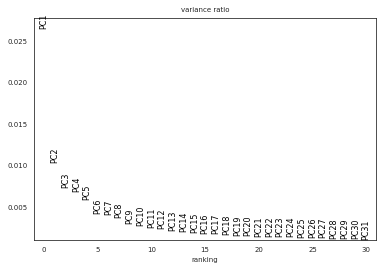

In [18]:
sc.tl.pca(adata, svd_solver='arpack',n_comps=n_comps) 
sc.pl.pca_variance_ratio(adata,log=False)

In [19]:
for i in adatas:
    sc.pp.neighbors(i, n_neighbors=10, method= 'umap', n_pcs=n_comps)
    sc.tl.umap(i)

In [20]:
for i in adatas:
    sc.tl.tsne(i, random_state = 7)

In [21]:
adata

AnnData object with n_obs × n_vars = 20702 × 16108
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'batch', 'primary_tumor', 'Limited', 'PValue_emptydrops', 'FDR_emptydrops', 'total_molecules', 'percent_mito', 'pheno_var_k10', 'pheno_var_k20', 'pheno_var_k30', 'pheno_var_k40', 'pheno_var_k50', 'pheno_var_k60', 'pheno_var_k70', 'pheno_var_k80', 'pheno_var_k90', 'pheno_var_k100', 'major_subsets'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap', 'X_tsne'
    varm: 'PCs'
    layers: 'raw'
    obsp: 'distances', 'connectivities'

In [22]:
for i in adatas:
    sc.tl.diffmap(i, n_comps=15, neighbors_key=None, copy=False)

In [23]:
for i in adatas:
    sc.tl.draw_graph(i, layout='fa', init_pos=None, root=None, random_state=0, n_jobs=None, adjacency=None, key_added_ext=None, neighbors_key=None, obsp=None, copy=False)

In [24]:
for i in adatas:
    for j,k in enumerate(pheno_names):
        result_pheno_ndf_all = sce.tl.phenograph(i.obsm['X_pca'], k = pheno_k[j])
        i.obs[k] = pd.Categorical(result_pheno_ndf_all[0])

Finding 10 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 10.629280805587769 seconds
Jaccard graph constructed in 4.548629283905029 seconds
Wrote graph to binary file in 0.7880799770355225 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.886259
After 6 runs, maximum modularity is Q = 0.887653
Louvain completed 26 runs in 6.090530157089233 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 25.244487285614014 seconds
Finding 20 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 10.213913440704346 seconds
Jaccard graph constructed in 4.9064881801605225 seconds
Wrote graph to binary file in 1.5325007438659668 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.859818
Louvain completed 21 runs in 6.263517141342163 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 26.161848306655884 seconds
Fi

In [25]:
adatas

[AnnData object with n_obs × n_vars = 20702 × 16108
     obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'batch', 'primary_tumor', 'Limited', 'PValue_emptydrops', 'FDR_emptydrops', 'total_molecules', 'percent_mito', 'pheno_var_k10', 'pheno_var_k20', 'pheno_var_k30', 'pheno_var_k40', 'pheno_var_k50', 'pheno_var_k60', 'pheno_var_k70', 'pheno_var_k80', 'pheno_var_k90', 'pheno_var_k100', 'major_subsets', 'pheno_TNK_k10', 'pheno_TNK_k20', 'pheno_TNK_k30', 'pheno_TNK_k40', 'pheno_TNK_k50', 'pheno_TNK_k60', 'pheno_TNK_k70', 'pheno_TNK_k80', 'pheno_TNK_k90', 'pheno_TNK_k100'
     var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
     uns: 'pca', 'neighbors', 'umap', 'diffmap_evals', 'draw_graph'
     obsm: 'X_pca', 'X_umap', 'X_tsne', 'X_diffmap', 'X_draw_gr

In [26]:
for i in adatas:
    a = magic(i, copy=True, verbose=True, solver= 'exact', n_pca=i.obsm['X_pca'].shape[1], knn=5, t=3)
    i.layers['imputed'] = a.X

Calculating MAGIC...
  Running MAGIC on 20702 cells and 16108 genes.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 11.72 seconds.
    Calculating KNN search...
    Calculated KNN search in 108.70 seconds.
    Calculating affinities...
    Calculated affinities in 108.45 seconds.
  Calculated graph and diffusion operator in 228.90 seconds.
  Running MAGIC with `solver='exact'` on 16108-dimensional data may take a long time. Consider denoising specific genes with `genes=<list-like>` or using `solver='approximate'`.
  Calculating imputation...


/home/wallet/.local/lib/python3.8/site-packages/magic/magic.py:500: FutureWarning: The SparseDataFrame class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  and isinstance(X, (pd.SparseDataFrame, sparse.spmatrix))


  Calculated imputation in 48.55 seconds.


/home/wallet/.local/lib/python3.8/site-packages/magic/utils.py:135: FutureWarning: The SparseDataFrame class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  if isinstance(target_data, pd.SparseDataFrame):


Calculated MAGIC in 278.41 seconds.


In [27]:
adatas

[AnnData object with n_obs × n_vars = 20702 × 16108
     obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'batch', 'primary_tumor', 'Limited', 'PValue_emptydrops', 'FDR_emptydrops', 'total_molecules', 'percent_mito', 'pheno_var_k10', 'pheno_var_k20', 'pheno_var_k30', 'pheno_var_k40', 'pheno_var_k50', 'pheno_var_k60', 'pheno_var_k70', 'pheno_var_k80', 'pheno_var_k90', 'pheno_var_k100', 'major_subsets', 'pheno_TNK_k10', 'pheno_TNK_k20', 'pheno_TNK_k30', 'pheno_TNK_k40', 'pheno_TNK_k50', 'pheno_TNK_k60', 'pheno_TNK_k70', 'pheno_TNK_k80', 'pheno_TNK_k90', 'pheno_TNK_k100'
     var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
     uns: 'pca', 'neighbors', 'umap', 'diffmap_evals', 'draw_graph'
     obsm: 'X_pca', 'X_umap', 'X_tsne', 'X_diffmap', 'X_draw_gr

### save data

In [28]:
#indicate save path
adata_save_path

'/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_TNK_scran_raw_counts_annotated_clustered.h5ad'

In [29]:
#save data
adatas[0].write(adata_save_path)
print('adata written to', adata_save_path)

adata written to /data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_TNK_scran_raw_counts_annotated_clustered.h5ad


# highly variable genes

In [37]:
#data paths
adata_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_TNK_scran_raw_counts_annotated_clustered.h5ad'

#adata with important obs elements
adata_save_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_TNK_scran_raw_counts_annotated_2500hv_clustered.h5ad'


#clustering parameters
number_of_hv_genes = 2500
exclude_batch_specific_hv = False
batch_key_tumors = 'batch'
#additional marker genes added to hv?
add_marker_genes = True
marker_gene_path = '/data/peer/wallet/Jupyter/PDAC_RT_Huber_Walle/immune_marker_panel_clean_210216.csv'
marker_gene_sets = ['TNK_important_marker','M_important_marker','DC_important_marker','ILC_important_marker','B_important_marker']

pheno_names = ['pheno_var_TNK_k10', 'pheno_var_TNK_k20', 'pheno_var_TNK_k30', 'pheno_var_TNK_k40', 'pheno_var_TNK_k50', 'pheno_TNK_k60',
              'pheno_var_TNK_k70','pheno_var_TNK_k80','pheno_var_TNK_k90','pheno_var_TNK_k100']
pheno_k = [10,20,30,40,50,60,70,80,90,100]


In [38]:
adata = sc.read(adata_path)

In [39]:
adata.obs['batch']

239932640480493-T23    T23
134376349133724-T13    T13
226970310199197-N08    N08
135150471440675-T02    T02
161864228190941-T02    T02
                      ... 
192317693487339-T16    T16
191708928629044-T12    T12
165232449043884-T02    T02
197185786014964-T18    T18
166288091176166-T15    T15
Name: batch, Length: 20702, dtype: category
Categories (34, object): [N01, N02, N03, N04, ..., T21, T22, T23, T24]

In [40]:
adata.layers['raw']

<20702x16108 sparse matrix of type '<class 'numpy.float32'>'
	with 17136805 stored elements in Compressed Sparse Row format>

### select highly variable genes

In [41]:
if exclude_batch_specific_hv ==True:
    sc.pp.highly_variable_genes(adata, layer='raw', flavor='seurat_v3', n_top_genes=number_of_hv_genes, batch_key=batch_key_tumors)
else:
    sc.pp.highly_variable_genes(adata, layer='raw', flavor='seurat_v3', n_top_genes=number_of_hv_genes)

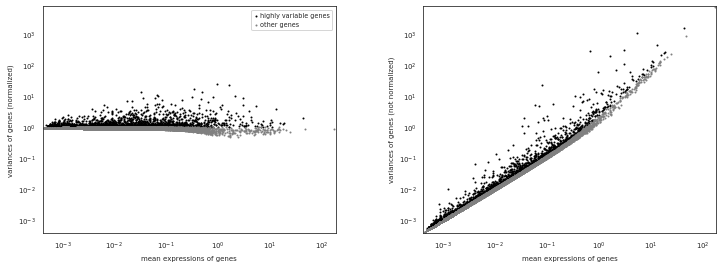

In [42]:
sc.pl.highly_variable_genes(adata, log=True, show=None, save=None, highly_variable_genes=True)

In [43]:
adata

AnnData object with n_obs × n_vars = 20702 × 16108
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'batch', 'primary_tumor', 'Limited', 'PValue_emptydrops', 'FDR_emptydrops', 'total_molecules', 'percent_mito', 'pheno_var_k10', 'pheno_var_k20', 'pheno_var_k30', 'pheno_var_k40', 'pheno_var_k50', 'pheno_var_k60', 'pheno_var_k70', 'pheno_var_k80', 'pheno_var_k90', 'pheno_var_k100', 'major_subsets', 'pheno_TNK_k10', 'pheno_TNK_k20', 'pheno_TNK_k30', 'pheno_TNK_k40', 'pheno_TNK_k50', 'pheno_TNK_k60', 'pheno_TNK_k70', 'pheno_TNK_k80', 'pheno_TNK_k90', 'pheno_TNK_k100'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'diffmap_evals', 'draw_graph', 'neighbors'

## add marker genes to highly variable

In [44]:
if add_marker_genes ==True:
    marker_genes_df = pd.read_csv(marker_gene_path, encoding='latin-1', index_col='gene_name')

In [45]:
#limit to human only
marker_genes_df = marker_genes_df[marker_genes_df['species'] == 'homo_sapiens']
marker_genes_df

,ENSEMBL_Gene,uniprot_ID,protein_name,species,protein_cytoplasm,protein_intracellular,protein_membrane,protein_nucleus,protein_secretory,cytokine,...,viral_entry_positive_reg_evidence,class,notes,UniProtID,UniProt_summary,citation,total_seq_A,total_seq_B,total_seq_C,last_curator
gene_name,,,,,,,,,,,,,,,,,,,,,
ACKR4,ENSG00000129048,NaN,NaN,homo_sapiens,NaN,False,True,False,False,False,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ACOD1,ENSG00000102794,NaN,NaN,homo_sapiens,NaN,NaN,NaN,NaN,NaN,False,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,wallet
ACTA1,ENSG00000143632,NaN,NaN,homo_sapiens,NaN,NaN,NaN,NaN,NaN,False,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ACTA2,ENSG00000107796,NaN,NaN,homo_sapiens,NaN,NaN,NaN,NaN,NaN,False,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ADAR,NaN,NaN,NaN,homo_sapiens,NaN,False,False,True,False,False,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,wallet
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZEB2,ENSG00000169554,O60315,NaN,homo_sapiens,NaN,True,False,NaN,False,False,...,NaN,marker,NaN,NaN,NaN,https://doi.org/10.1111/imm.12888,FALSE,False,False,wallet
CNTF,ENSG00000242689,NaN,NaN,homo_sapiens,NaN,NaN,NaN,NaN,NaN,True,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CNTFR,ENSG00000122756,NaN,NaN,homo_sapiens,NaN,NaN,NaN,NaN,NaN,False,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [46]:
#limit to markers used for distinguishing immune from tumor cells
marker_genes_df = marker_genes_df[marker_gene_sets]

In [47]:
marker_genes_df

,TNK_important_marker,M_important_marker,DC_important_marker,ILC_important_marker,B_important_marker
gene_name,,,,,
ACKR4,NaN,NaN,NaN,NaN,NaN
ACOD1,False,True,False,NaN,False
ACTA1,NaN,NaN,NaN,NaN,NaN
ACTA2,NaN,NaN,NaN,NaN,NaN
ADAR,False,False,False,False,False
...,...,...,...,...,...
ZEB2,False,True,False,NaN,False
CNTF,NaN,NaN,NaN,NaN,NaN
CNTFR,NaN,NaN,NaN,NaN,NaN


In [48]:
#extract gene names
marker_lists = []
for i in marker_gene_sets:
    marker_genes_list = list(set(marker_genes_df[marker_genes_df[i]==True].index))
    marker_lists.append(marker_genes_list)
marker_lists

[['NCR3',
  'TNFRSF18',
  'CD226',
  'NFATC2',
  'EGR2',
  'IL17RB',
  'CD3D',
  'CD274',
  'IL6',
  'BCL6',
  'PTGDR2',
  'NKG7',
  'TRAC',
  'KIR3DL2',
  'IL2RA',
  'KLRC2',
  'ITGA5',
  'MERTK',
  'NCAM1',
  'IL6R',
  'CX3CR1',
  'IL9',
  'AHR',
  'IL1R1',
  'CD160',
  'KLRK1',
  'PDGFRA',
  'CXCR3',
  'KLRB1',
  'TRGC1',
  'KIR2DL3',
  'IL17A',
  'LAG3',
  'ITGAE',
  'ITGA2',
  'PDGFRB',
  'IL5',
  'FGFBP2',
  'SELL',
  'VSIR',
  'CCR6',
  'TNFRSF4',
  'PF4',
  'IL13RA1',
  'TNF',
  'NT5E',
  'TIGIT',
  'TYRO3',
  'KLRG1',
  'PPBP',
  'TNFSF11',
  'GNLY',
  'HLA-DRB3',
  'SIRPA',
  'CD3G',
  'CEACAM1',
  'GZMB',
  'TBX21',
  'CD2',
  'ALK4',
  'IL17F',
  'FOXP3',
  'TRDC',
  'CD27',
  'IL22',
  'KIR2DL5A',
  'TGFB1',
  'CCR4',
  'GATA3',
  'CD4',
  'KIR3DL3',
  'RUNX3',
  'CXCR2',
  'CXCR5',
  'HAVCR2',
  'TGFB2',
  'FCGR3B',
  'CXCR1',
  'AXL',
  'ICOS',
  'IL2RB',
  'INHBA',
  'TOX',
  'IL4',
  'ATXN1',
  'IFNG',
  'KIR2DL4',
  'IL17B',
  'STXBP2',
  'S1PR1',
  'IL23R',
  'CD44',

In [49]:
#concatenate lists
import itertools
a = marker_lists
marker_genes = list(itertools.chain.from_iterable(a))
marker_genes

['NCR3',
 'TNFRSF18',
 'CD226',
 'NFATC2',
 'EGR2',
 'IL17RB',
 'CD3D',
 'CD274',
 'IL6',
 'BCL6',
 'PTGDR2',
 'NKG7',
 'TRAC',
 'KIR3DL2',
 'IL2RA',
 'KLRC2',
 'ITGA5',
 'MERTK',
 'NCAM1',
 'IL6R',
 'CX3CR1',
 'IL9',
 'AHR',
 'IL1R1',
 'CD160',
 'KLRK1',
 'PDGFRA',
 'CXCR3',
 'KLRB1',
 'TRGC1',
 'KIR2DL3',
 'IL17A',
 'LAG3',
 'ITGAE',
 'ITGA2',
 'PDGFRB',
 'IL5',
 'FGFBP2',
 'SELL',
 'VSIR',
 'CCR6',
 'TNFRSF4',
 'PF4',
 'IL13RA1',
 'TNF',
 'NT5E',
 'TIGIT',
 'TYRO3',
 'KLRG1',
 'PPBP',
 'TNFSF11',
 'GNLY',
 'HLA-DRB3',
 'SIRPA',
 'CD3G',
 'CEACAM1',
 'GZMB',
 'TBX21',
 'CD2',
 'ALK4',
 'IL17F',
 'FOXP3',
 'TRDC',
 'CD27',
 'IL22',
 'KIR2DL5A',
 'TGFB1',
 'CCR4',
 'GATA3',
 'CD4',
 'KIR3DL3',
 'RUNX3',
 'CXCR2',
 'CXCR5',
 'HAVCR2',
 'TGFB2',
 'FCGR3B',
 'CXCR1',
 'AXL',
 'ICOS',
 'IL2RB',
 'INHBA',
 'TOX',
 'IL4',
 'ATXN1',
 'IFNG',
 'KIR2DL4',
 'IL17B',
 'STXBP2',
 'S1PR1',
 'IL23R',
 'CD44',
 'TRBC2',
 'NFATC1',
 'LAMP2',
 'IL12RB1',
 'IL17RA',
 'KLRC1',
 'GZMA',
 'CCR10',
 'HMGB1'

In [50]:
#set important marker genes as highly variable

for i in marker_genes:
    if i in adata.var_names:
        adata.var['highly_variable'][i]= True
    else:
        print(i, 'not found')

PTGDR2 not found
IL9 not found
IL5 not found
VSIR not found
PF4 not found
HLA-DRB3 not found
ALK4 not found
IL22 not found
KIR2DL5A not found
KIR3DL3 not found
IL17B not found
TNFRSF9  not found
KIR2DL5B not found
HLA-DRB4 not found
IL21 not found
HAVCR1 not found
KIR2DL2 not found
ARG1 not found
SCARF2 not found
CLEC9A not found
C8A not found
NOS2 not found
GPX5 not found
AZU1 not found
S100A15 not found
HLA-DRB3 not found
MASP1 not found
ZBTB46  not found
ACOD1 not found
RAGE not found
STAB2 not found
C4B not found
C4A not found
XCR1 not found
FCRLS not found
FCGR2C not found
IL12B not found
SIGLEC8 not found
CD209 not found
GPX6 not found
C9 not found
SIGLEC6 not found
MBL2 not found
TPSD1  not found
SRCRB4D not found
SCARA5 not found
TACE not found
CEACAM8 not found
HLA-DRB4 not found
ELANE not found
MEGF10 not found
CLEC4C not found
XCR1 not found
FCGR2C not found
ZBTB46  not found
CD209 not found
CLEC9A not found
CLEC4C not found
SIGLEC6 not found
HLA-DRB3 not found
HLA-DRB4 not 

<ipython-input-50-622275f32bb2>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.var['highly_variable'][i]= True


In [51]:
adata[:,'FASLG'].var['highly_variable']

FASLG    True
Name: highly_variable, dtype: bool

## cluster

In [52]:
adatas = [adata]

## PCA neighbors clustering imputation

In [53]:
adata.X

array([[0.       , 0.       , 0.       , ..., 0.       , 0.       ,
        0.       ],
       [0.       , 0.       , 0.       , ..., 0.       , 0.       ,
        0.       ],
       [0.8902812, 0.8902812, 0.       , ..., 0.       , 0.       ,
        0.       ],
       ...,
       [0.       , 0.       , 0.       , ..., 0.       , 0.       ,
        0.       ],
       [0.       , 0.       , 0.       , ..., 0.       , 0.       ,
        0.       ],
       [0.       , 0.       , 0.       , ..., 0.       , 0.       ,
        0.       ]], dtype=float32)

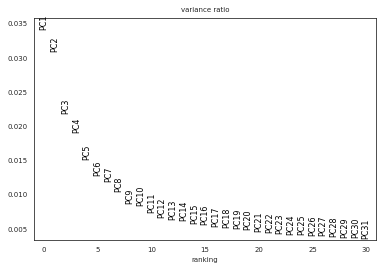

In [54]:
#PCA
%matplotlib inline

sc.tl.pca(adata, svd_solver='arpack',n_comps=100, use_highly_variable=True) 
sc.pl.pca_variance_ratio(adata,log=False)

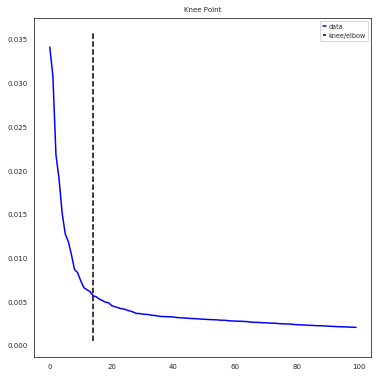

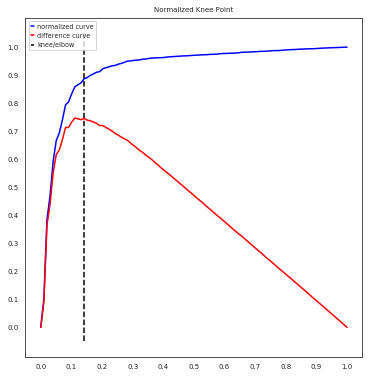

Kneepoint happens at PC: 14
14 PC explain 19.957046722993255 % of variance


In [55]:
a = adata.copy()# PCs kneepoint
x = [i for i in range(len(a.uns["pca"]["variance_ratio"]))]
y = list(a.uns["pca"]["variance_ratio"])
kneedle = KneeLocator(x,
                      y,
                      S=1,
                      curve='convex',
                      direction='decreasing',
                      online=False)
kn_pc = round(kneedle.knee, 3)
kneedle.plot_knee()
plt.show()
kneedle.plot_knee_normalized()
plt.show()
print("Kneepoint happens at PC:", kn_pc)

exp_var = sum(adata.uns['pca']['variance_ratio'][:kn_pc])
exp_var_test_percent = exp_var*100
print(kn_pc,'PC explain',exp_var_test_percent, '% of variance')


In [56]:
#find number of PCs explaining at least 20% of variance
tested_PC_number = kn_pc

while exp_var_test_percent <20:
    tested_PC_number = tested_PC_number+1
    exp_var_test = sum(adata.uns['pca']['variance_ratio'][0:tested_PC_number])
    exp_var_test_percent = exp_var_test*100
    print(tested_PC_number, 'PC explain',exp_var_test_percent, '% of variance')

15 PC explain 20.526508754119277 % of variance


### set number of principal components

In [57]:
#set number of components according to kneepoint and explained variance
n_comps = tested_PC_number
print('number of PCs for clusterings/embeddings is:', n_comps)

number of PCs for clusterings/embeddings is: 15


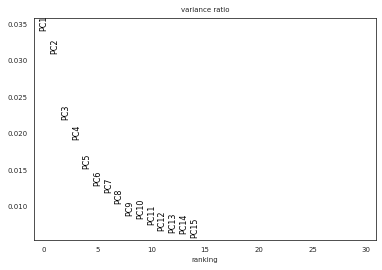

In [58]:
sc.tl.pca(adata, svd_solver='arpack',n_comps=n_comps, use_highly_variable=True) 
sc.pl.pca_variance_ratio(adata,log=False)

In [59]:
for i in adatas:
    sc.pp.neighbors(i, n_neighbors=10, method= 'umap', n_pcs=n_comps)
    sc.tl.umap(i)

In [60]:
for i in adatas:
    sc.tl.tsne(i, random_state = 7)

In [61]:
adata

AnnData object with n_obs × n_vars = 20702 × 16108
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'batch', 'primary_tumor', 'Limited', 'PValue_emptydrops', 'FDR_emptydrops', 'total_molecules', 'percent_mito', 'pheno_var_k10', 'pheno_var_k20', 'pheno_var_k30', 'pheno_var_k40', 'pheno_var_k50', 'pheno_var_k60', 'pheno_var_k70', 'pheno_var_k80', 'pheno_var_k90', 'pheno_var_k100', 'major_subsets', 'pheno_TNK_k10', 'pheno_TNK_k20', 'pheno_TNK_k30', 'pheno_TNK_k40', 'pheno_TNK_k50', 'pheno_TNK_k60', 'pheno_TNK_k70', 'pheno_TNK_k80', 'pheno_TNK_k90', 'pheno_TNK_k100'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'diffmap_evals', 'draw_graph', 'neighbors'

In [62]:
for i in adatas:
    sc.tl.diffmap(i, n_comps=15, neighbors_key=None, copy=False)

In [63]:
for i in adatas:
    sc.tl.draw_graph(i, layout='fa', init_pos=None, root=None, random_state=0, n_jobs=None, adjacency=None, key_added_ext=None, neighbors_key=None, obsp=None, copy=False)

In [64]:
for i in adatas:
    for j,k in enumerate(pheno_names):
        result_pheno_ndf_all = sce.tl.phenograph(i.obsm['X_pca'], k = pheno_k[j])
        i.obs[k] = pd.Categorical(result_pheno_ndf_all[0])

Finding 10 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 10.67729640007019 seconds
Jaccard graph constructed in 4.642497539520264 seconds
Wrote graph to binary file in 1.0084986686706543 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.872415
After 6 runs, maximum modularity is Q = 0.873437
Louvain completed 26 runs in 9.380017280578613 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 29.260668992996216 seconds
Finding 20 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 10.597846508026123 seconds
Jaccard graph constructed in 6.415279150009155 seconds
Wrote graph to binary file in 1.9945392608642578 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.837122
Louvain completed 21 runs in 15.00487732887268 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 38.66202449798584 seconds
Findi

In [65]:
adatas

[AnnData object with n_obs × n_vars = 20702 × 16108
     obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'batch', 'primary_tumor', 'Limited', 'PValue_emptydrops', 'FDR_emptydrops', 'total_molecules', 'percent_mito', 'pheno_var_k10', 'pheno_var_k20', 'pheno_var_k30', 'pheno_var_k40', 'pheno_var_k50', 'pheno_var_k60', 'pheno_var_k70', 'pheno_var_k80', 'pheno_var_k90', 'pheno_var_k100', 'major_subsets', 'pheno_TNK_k10', 'pheno_TNK_k20', 'pheno_TNK_k30', 'pheno_TNK_k40', 'pheno_TNK_k50', 'pheno_TNK_k60', 'pheno_TNK_k70', 'pheno_TNK_k80', 'pheno_TNK_k90', 'pheno_TNK_k100', 'pheno_var_TNK_k10', 'pheno_var_TNK_k20', 'pheno_var_TNK_k30', 'pheno_var_TNK_k40', 'pheno_var_TNK_k50', 'pheno_var_TNK_k70', 'pheno_var_TNK_k80', 'pheno_var_TNK_k90', 'pheno_var_TNK_k100'
     var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pc

In [66]:
for i in adatas:
    a = magic(i, copy=True, verbose=True, solver= 'exact', n_pca=i.obsm['X_pca'].shape[1], knn=5, t=3)
    i.layers['imputed'] = a.X

Calculating MAGIC...
  Running MAGIC on 20702 cells and 16108 genes.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 10.64 seconds.
    Calculating KNN search...
    Calculated KNN search in 12.29 seconds.
    Calculating affinities...
    Calculated affinities in 15.09 seconds.
  Calculated graph and diffusion operator in 38.09 seconds.
  Running MAGIC with `solver='exact'` on 16108-dimensional data may take a long time. Consider denoising specific genes with `genes=<list-like>` or using `solver='approximate'`.
  Calculating imputation...


/home/wallet/.local/lib/python3.8/site-packages/magic/magic.py:500: FutureWarning: The SparseDataFrame class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  and isinstance(X, (pd.SparseDataFrame, sparse.spmatrix))


  Calculated imputation in 28.14 seconds.


/home/wallet/.local/lib/python3.8/site-packages/magic/utils.py:135: FutureWarning: The SparseDataFrame class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  if isinstance(target_data, pd.SparseDataFrame):


Calculated MAGIC in 67.11 seconds.


In [67]:
adatas

[AnnData object with n_obs × n_vars = 20702 × 16108
     obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'batch', 'primary_tumor', 'Limited', 'PValue_emptydrops', 'FDR_emptydrops', 'total_molecules', 'percent_mito', 'pheno_var_k10', 'pheno_var_k20', 'pheno_var_k30', 'pheno_var_k40', 'pheno_var_k50', 'pheno_var_k60', 'pheno_var_k70', 'pheno_var_k80', 'pheno_var_k90', 'pheno_var_k100', 'major_subsets', 'pheno_TNK_k10', 'pheno_TNK_k20', 'pheno_TNK_k30', 'pheno_TNK_k40', 'pheno_TNK_k50', 'pheno_TNK_k60', 'pheno_TNK_k70', 'pheno_TNK_k80', 'pheno_TNK_k90', 'pheno_TNK_k100', 'pheno_var_TNK_k10', 'pheno_var_TNK_k20', 'pheno_var_TNK_k30', 'pheno_var_TNK_k40', 'pheno_var_TNK_k50', 'pheno_var_TNK_k70', 'pheno_var_TNK_k80', 'pheno_var_TNK_k90', 'pheno_var_TNK_k100'
     var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pc

### save data

In [68]:
#indicate save path
adata_save_path

'/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_TNK_scran_raw_counts_annotated_2500hv_clustered.h5ad'

In [69]:
#save data
adatas[0].write(adata_save_path)
print('adata written to', adata_save_path)

adata written to /data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_TNK_scran_raw_counts_annotated_2500hv_clustered.h5ad



# plot results


# plot results

In [70]:
#standard variables
TNK_suffix = '_TNK'
B_suffix = '_Bcell'
M_suffix = '_myeloid'

#pheno_names = ['pheno_TNK_k10', 'pheno_TNK_k20', 'pheno_TNK_k30', 'pheno_TNK_k40', 'pheno_TNK_k50', 'pheno_TNK_k60',
#              'pheno_TNK_k70','pheno_TNK_k80','pheno_TNK_k90','pheno_TNK_k100']
pheno_names = ['pheno_var_TNK_k10', 'pheno_var_TNK_k20', 'pheno_var_TNK_k30', 'pheno_var_TNK_k40', 'pheno_var_TNK_k50', 'pheno_TNK_k60',
              'pheno_var_TNK_k70','pheno_var_TNK_k80','pheno_var_TNK_k90','pheno_var_TNK_k100']
continue_with_adata = False

#set variables
#adata_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_TNK_scran_raw_counts_annotated_clustered.h5ad'
#adata_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_TNK_scran_raw_counts_annotated_7500hv_clustered.h5ad'
#adata_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_TNK_scran_raw_counts_annotated_5000hv_clustered.h5ad'
adata_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_TNK_scran_raw_counts_annotated_2500hv_clustered.h5ad'

markers_plot_M = ['CD68','MRC1','CD14','ID2','TCF4','IRF4','IRF8','IRF7','BATF3','FUT4','CD207','LY6G','CSF3R','TPSAB1','TPSB2','HDC','FUT4','VASP','CSF3R','ACOD1','FFAR4','LY6G','MPO','CTSG','LTF']
markers_plot_TNK = ['CD3D','CD3E','CD3G','CD4','CD8A','TRAC','TRBC1','TRGC1','TRDC','IL2RA','FOXP3','CCR7','SELL','CD27','CD28','CD69','ITGAL','CXCR3','IL2RB','CD58','CD57','NCR1','KLRB1C','PRF1','THY1','IL7R','EOMES','TBX21','IL1R2','CD200R1','TRAIL','ITGA1','ICOS','KLRG1','GATA3','RORA','AHR','TNFSF11','RORC','KIT','ITGA4','IL1R1','IL33']
markers_plot_B = ['MS4A1','CD19','CD27','SDC1','IGHG1','IGHG2B','IGHG2C','IGHG3','IGHA','IGHE','IGHD','IGHM','MKI67']
markers_plot = markers_plot_TNK

In [71]:
#load subset files
if continue_with_adata == False:
    adata = sc.read(adata_path)

In [72]:
adatas = [adata]

In [73]:
#randomize cells for plotting
for i in adatas:
    i = randomize_cells(i)

In [74]:
# Filter out genes not present in single cell data
marker_genes_filtered = []
for marker in markers_plot:
    if marker in adata.var.index:   
        marker_genes_filtered.append(marker)
    else:
        print(marker + ' filtered out')
marker_genes_filtered = list(set(marker_genes_filtered))

CD57 filtered out
KLRB1C filtered out
TRAIL filtered out


In [75]:
adata.obs

,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,batch,primary_tumor,...,pheno_TNK_k100,pheno_var_TNK_k10,pheno_var_TNK_k20,pheno_var_TNK_k30,pheno_var_TNK_k40,pheno_var_TNK_k50,pheno_var_TNK_k70,pheno_var_TNK_k80,pheno_var_TNK_k90,pheno_var_TNK_k100
239932640480493-T23,643,6.467699,1094.214355,6.998705,18.329191,30.589647,46.784480,82.822077,T23,True,...,12,5,7,8,8,8,8,8,9,3
134376349133724-T13,1201,7.091742,1226.135742,7.112438,13.933024,23.968405,37.675832,60.918630,T13,True,...,16,16,13,13,10,10,16,16,16,15
226970310199197-N08,976,6.884487,1280.038696,7.155427,16.980954,28.991959,42.826553,66.893669,N08,False,...,8,19,4,6,9,6,9,4,5,8
135150471440675-T02,925,6.830874,1180.646484,7.074664,15.129919,24.951933,38.928799,65.641645,T02,True,...,1,0,0,0,1,0,0,0,0,1
161864228190941-T02,631,6.448889,1113.983398,7.016595,18.205968,30.130648,46.812915,83.834083,T02,True,...,1,0,13,0,1,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
192317693487339-T16,802,6.688355,1133.500488,7.033948,16.035683,27.197202,42.583388,71.863688,T16,True,...,6,1,9,9,0,1,6,9,8,0
191708928629044-T12,1650,7.409136,1335.292480,7.197654,14.796794,25.263079,38.078474,58.756463,T12,True,...,11,6,9,9,0,1,2,9,8,0
165232449043884-T02,656,6.487684,1127.500000,7.028645,16.680715,27.582186,43.642079,80.719656,T02,True,...,2,4,8,4,4,5,4,3,3,6
197185786014964-T18,613,6.419995,1027.893799,6.936240,18.173172,30.841098,48.711811,85.967150,T18,True,...,1,0,0,0,1,0,0,0,0,1



# plot results

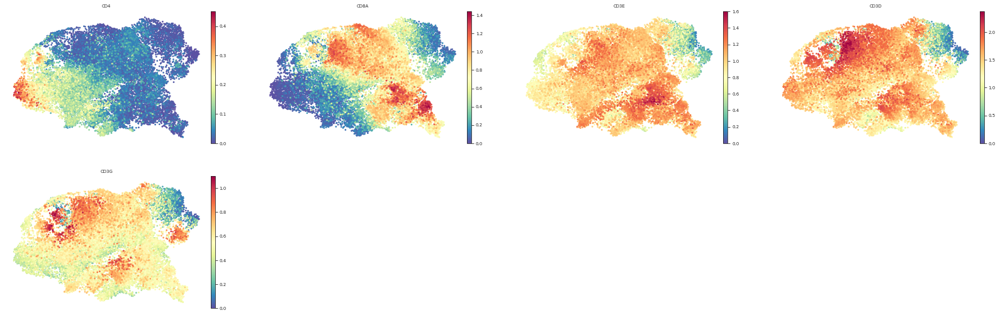

In [76]:
sc.pl.umap(adata, color = ['CD4','CD8A','CD3E','CD3D','CD3G'], s = 30, cmap='Spectral_r', layer='imputed', legend_fontsize = 10, vmin=0)


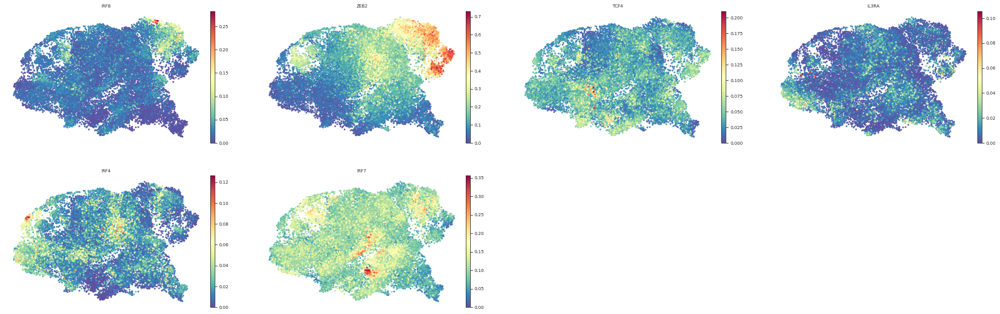

In [77]:
sc.pl.umap(adata, color = ['IRF8', 'ZEB2','TCF4','IL3RA','IRF4','IRF7'], s = 30, cmap='Spectral_r', layer='imputed', legend_fontsize = 10, vmin=0)


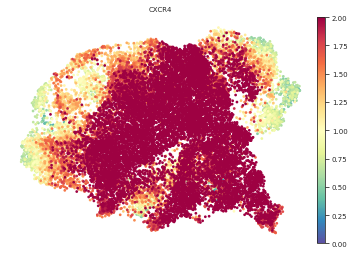

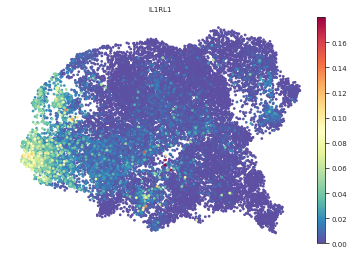

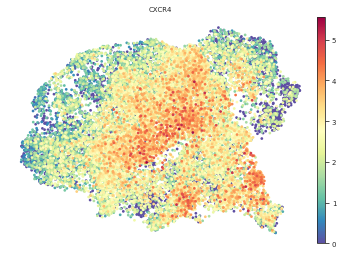

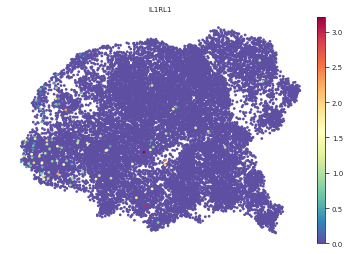

In [78]:
sc.pl.umap(adata, color = ['CXCR4'], s = 30, cmap='Spectral_r', layer='imputed', legend_fontsize = 10, vmin=0,vmax=2)
sc.pl.umap(adata, color = ['IL1RL1'], s = 30, cmap='Spectral_r', layer='imputed', legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = ['CXCR4'], s = 30, cmap='Spectral_r', legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = ['IL1RL1'], s = 30, cmap='Spectral_r',legend_fontsize = 10, vmin=0)

In [79]:
adata.obs['primary_tumor'] = pd.Categorical(adata.obs['primary_tumor'])

In [80]:
i

View of AnnData object with n_obs × n_vars = 20702 × 16108
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'batch', 'primary_tumor', 'Limited', 'PValue_emptydrops', 'FDR_emptydrops', 'total_molecules', 'percent_mito', 'pheno_var_k10', 'pheno_var_k20', 'pheno_var_k30', 'pheno_var_k40', 'pheno_var_k50', 'pheno_var_k60', 'pheno_var_k70', 'pheno_var_k80', 'pheno_var_k90', 'pheno_var_k100', 'major_subsets', 'pheno_TNK_k10', 'pheno_TNK_k20', 'pheno_TNK_k30', 'pheno_TNK_k40', 'pheno_TNK_k50', 'pheno_TNK_k60', 'pheno_TNK_k70', 'pheno_TNK_k80', 'pheno_TNK_k90', 'pheno_TNK_k100', 'pheno_var_TNK_k10', 'pheno_var_TNK_k20', 'pheno_var_TNK_k30', 'pheno_var_TNK_k40', 'pheno_var_TNK_k50', 'pheno_var_TNK_k70', 'pheno_var_TNK_k80', 'pheno_var_TNK_k90', 'pheno_var_TNK_k100'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts'

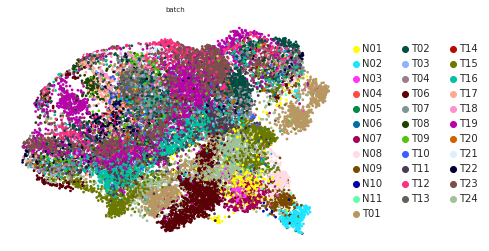

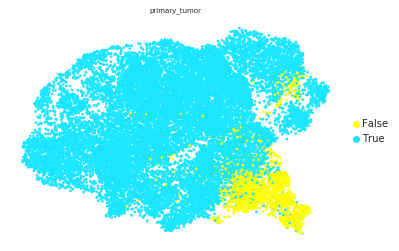

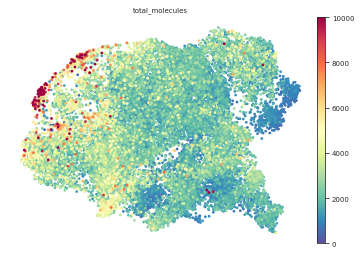

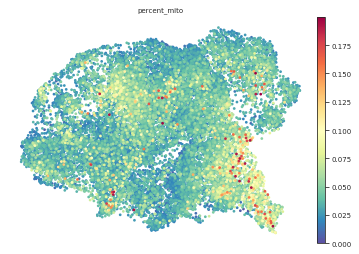

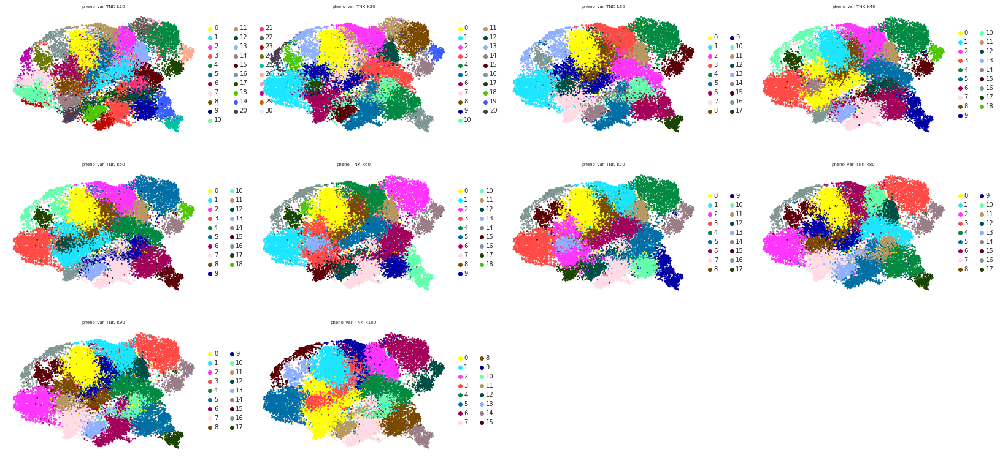

...

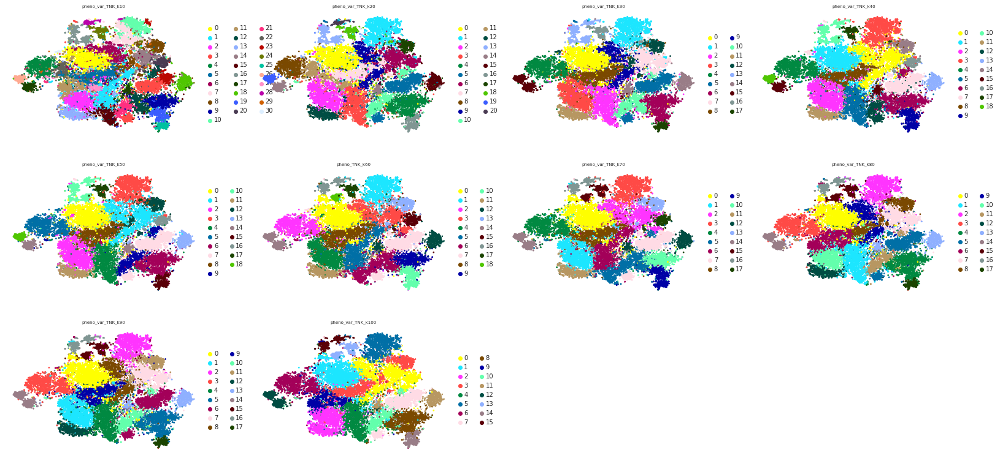

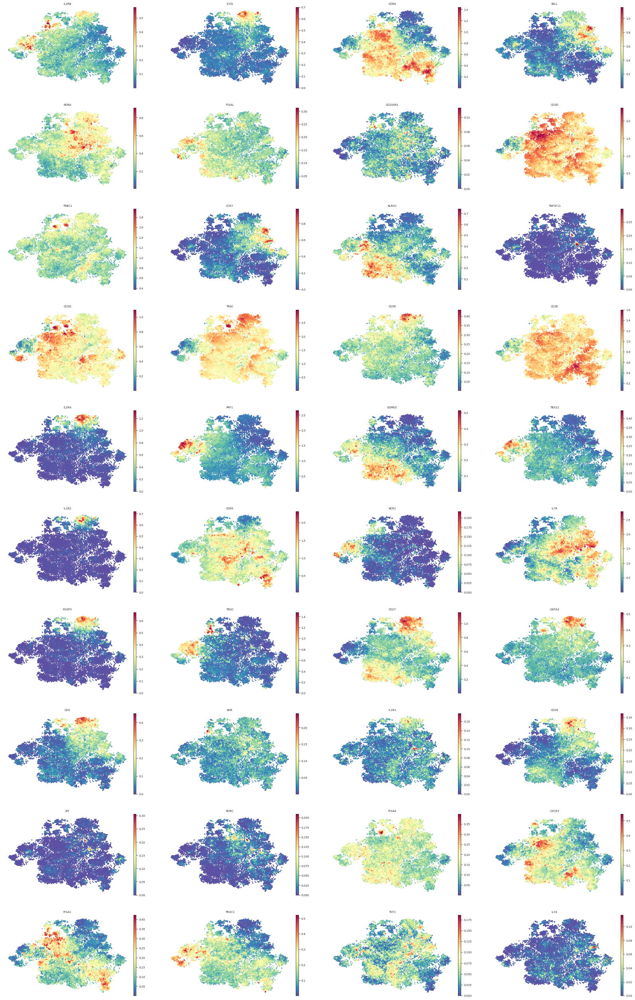

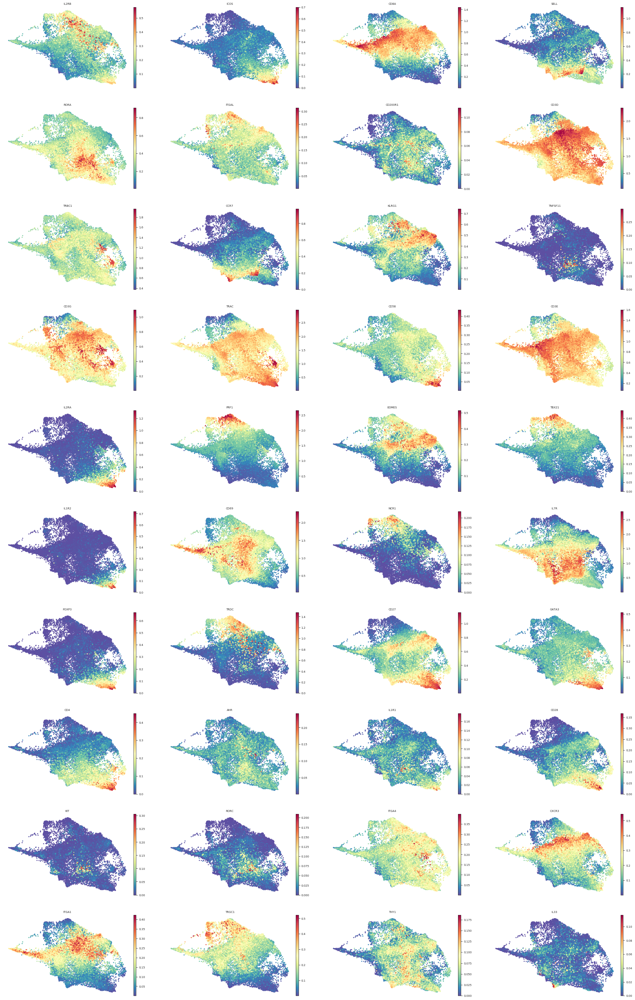

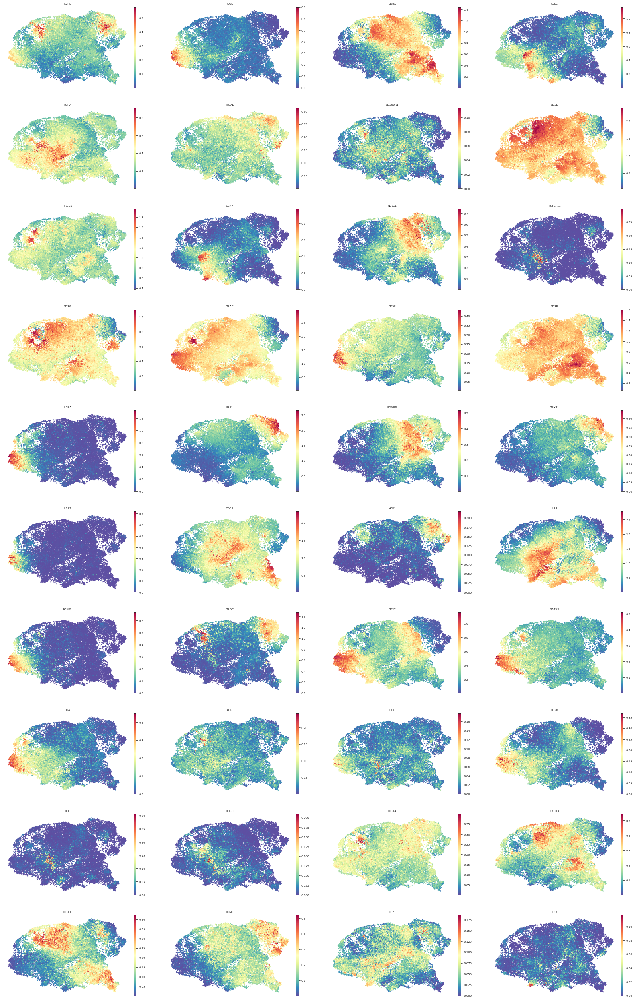

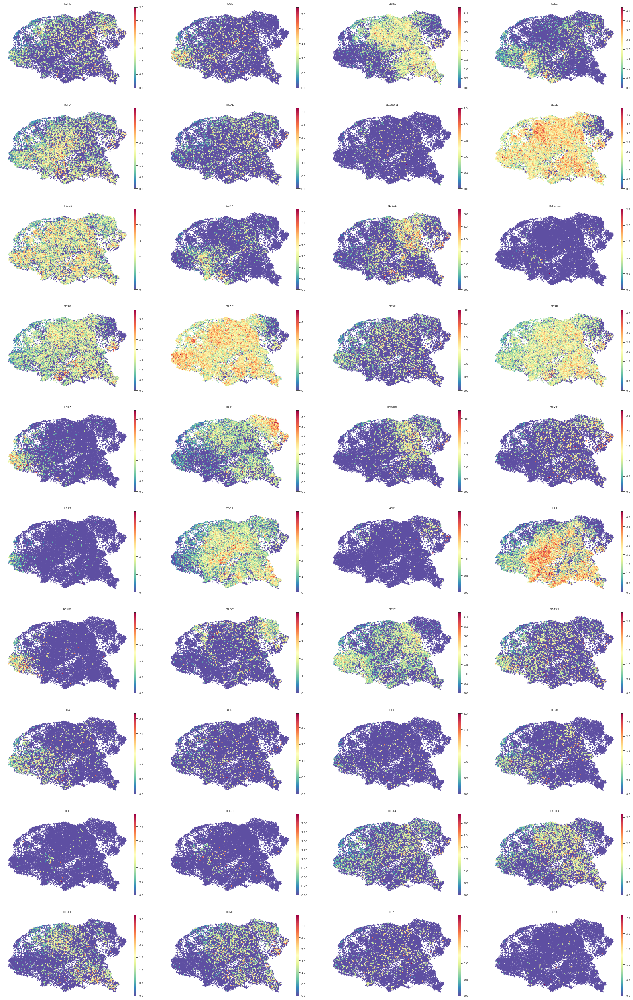

In [87]:
### plot cell subsets
%matplotlib inline
sns.set_style('white')
for i in adatas:
    sc.pl.umap(i, color = ['batch'], s = 30, palette=color_map_clusters, legend_fontsize = 10, vmin=0)
    sc.pl.umap(i, color = ['primary_tumor'], s = 30, palette=color_map_clusters, legend_fontsize = 10, vmin=0)
    sc.pl.umap(i, color = ['total_molecules'], s = 30, cmap='Spectral_r', legend_fontsize = 10, vmin=0, vmax=10000)
    sc.pl.umap(i, color = ['percent_mito'], s = 30, cmap='Spectral_r', legend_fontsize = 10, vmin=0)
    sc.pl.umap(i, color = pheno_names, s = 30, palette=color_map_clusters, legend_fontsize = 10, vmin=0)
    sc.pl.diffmap(i, color = ['batch'], s = 30, palette=color_map_clusters, legend_fontsize = 10, vmin=0)
    sc.pl.diffmap(i, color = pheno_names, s = 30, palette=color_map_clusters, legend_fontsize = 10, vmin=0)
    sc.pl.draw_graph(i, color = ['batch'], s = 30, palette=color_map_clusters, legend_fontsize = 10, vmin=0)
    sc.pl.draw_graph(i, color = pheno_names, s = 30, palette=color_map_clusters, legend_fontsize = 10, vmin=0)
    sc.pl.tsne(i, color = ['batch'], s = 30, palette=color_map_clusters, legend_fontsize = 10, vmin=0)
    sc.pl.tsne(i, color = pheno_names, s = 30, palette=color_map_clusters, legend_fontsize = 10, vmin=0)
    sc.pl.tsne(i, color = marker_genes_filtered,  layer = 'imputed', s = 30, cmap= 'Spectral_r', legend_fontsize = 10)
    sc.pl.draw_graph(i, color = marker_genes_filtered,  layer = 'imputed', s = 30, cmap= 'Spectral_r', legend_fontsize = 10)
    sc.pl.umap(i, color = marker_genes_filtered,  layer = 'imputed', s = 30, cmap= 'Spectral_r', legend_fontsize = 10)
    sc.pl.umap(i, color = marker_genes_filtered,  layer = None, s = 30, cmap= 'Spectral_r', legend_fontsize = 10)

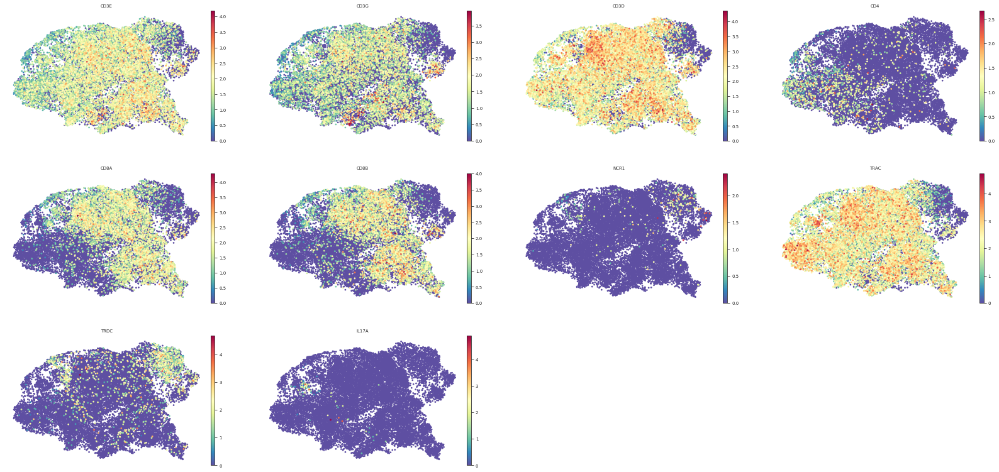

In [88]:
sc.pl.umap(adata, color = ['CD3E','CD3G','CD3D','CD4','CD8A','CD8B','NCR1','TRAC','TRDC','IL17A'],  layer = None, s = 30, cmap= 'Spectral_r', legend_fontsize = 10)

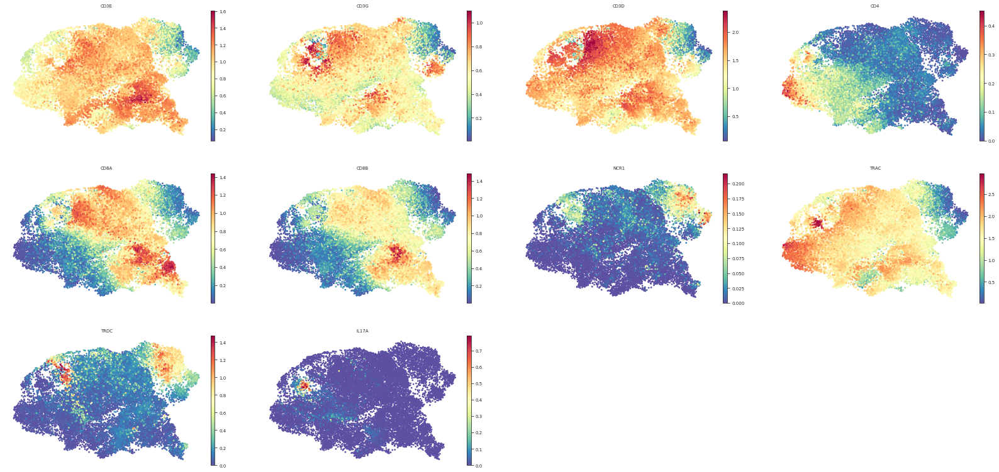

In [89]:
sc.pl.umap(adata, color = ['CD3E','CD3G','CD3D','CD4','CD8A','CD8B','NCR1','TRAC','TRDC','IL17A'], layer='imputed', s = 30, cmap= 'Spectral_r', legend_fontsize = 10)

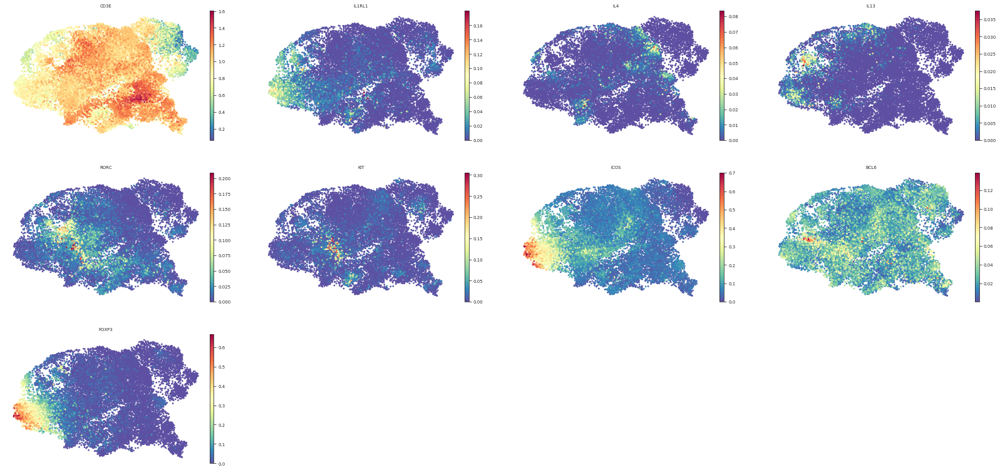

In [90]:
sc.pl.umap(adata, color = ['CD3E','IL1RL1','IL4','IL13','RORC','KIT','ICOS','BCL6','FOXP3'],  layer = 'imputed', s = 30, cmap= 'Spectral_r', legend_fontsize = 10)

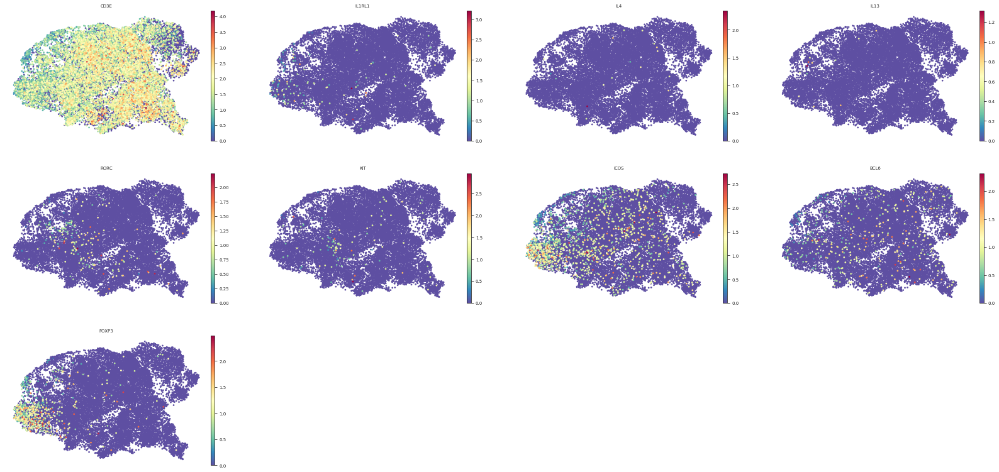

In [91]:
sc.pl.umap(adata, color = ['CD3E','IL1RL1','IL4','IL13','RORC','KIT','ICOS','BCL6','FOXP3'],  layer = None, s = 30, cmap= 'Spectral_r', legend_fontsize = 10)

## highlight clusters of interest

In [95]:
#creat list of list with sample ids to execute code below

sample_ids = list(set(adata.obs['batch']))
                  
                  
condition_to_highlight = []
                  
for i in sample_ids:
    condition_to_highlight.append([i])

In [96]:
condition_to_highlight

[['T04'],
 ['T09'],
 ['N08'],
 ['N07'],
 ['T20'],
 ['T03'],
 ['T18'],
 ['T19'],
 ['T13'],
 ['T24'],
 ['T22'],
 ['T01'],
 ['T02'],
 ['T16'],
 ['T14'],
 ['N04'],
 ['T08'],
 ['T06'],
 ['N09'],
 ['T12'],
 ['T15'],
 ['N01'],
 ['N06'],
 ['N11'],
 ['N05'],
 ['T23'],
 ['T17'],
 ['T07'],
 ['T10'],
 ['N03'],
 ['T11'],
 ['T21'],
 ['N02'],
 ['N10']]

In [97]:
#higlight cluster of interest
condition_name = 'batch'
highlight_color_list = '#FF4A46'

#data
adata_bool = adatas[0]

#colors
fade_color = '#e1e1e1'

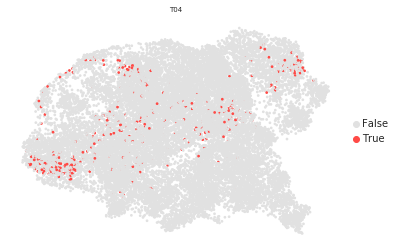

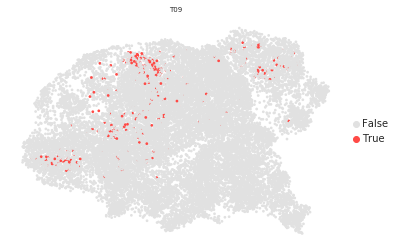

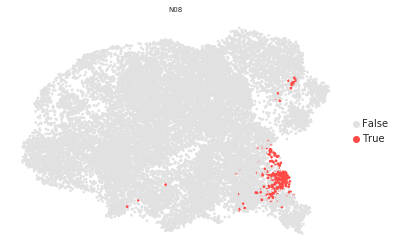

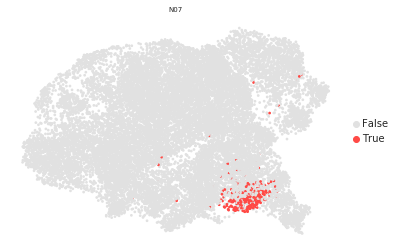

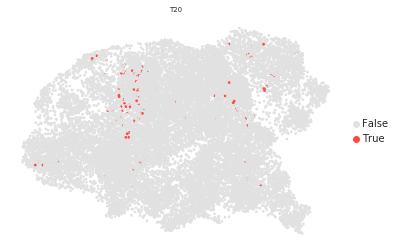

...

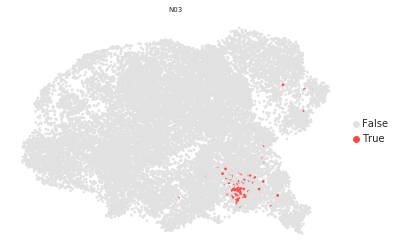

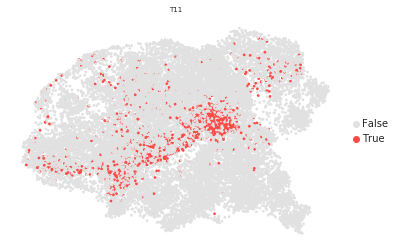

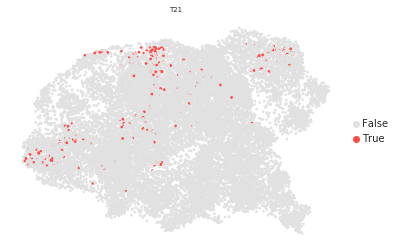

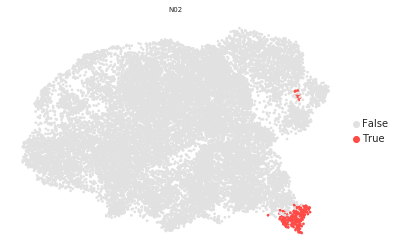

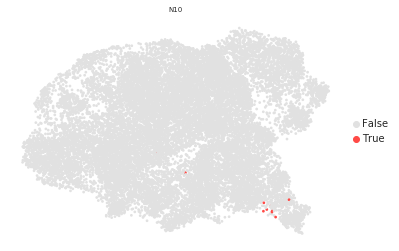

In [101]:
#create boolean list indicating membership to cluster(s) of interest
for v,j in enumerate(condition_to_highlight):
    clusters_highlight_bool = []
    color_map_highlight = [fade_color, highlight_color_list]

    for i in adata_bool.obs.index:
        cluster_bool = adata_bool.obs.loc[i,:][condition_name] in j #loop over indices to assess whether cluster membership of each index is included in cluster memberships of interest
        clusters_highlight_bool.append(cluster_bool)
    
    #add new column to AnnData .obs element to indicate membership of cell index to cluster group of interest

    adata_bool.obs['cluster_of_interest'] = pd.Categorical(clusters_highlight_bool)
    
    #plot
    %matplotlib inline 
    sc.pl.umap(adata_bool, color = ['cluster_of_interest'],layer='imputed', s = 30, palette=color_map_highlight,legend_fontsize = 10, vmin=0, title= '-'.join(j))

In [102]:
set(adatas[0].obs['primary_tumor'])

{False, True}

In [111]:
#higlight cluster of interest
condition_to_highlight = [['False'],['True']]
condition_name = 'primary_tumor'
highlight_color_list = ['#FF4A46','#407AFF']
#data
adata_bool = adatas[0]

#colors
fade_color = '#e1e1e1'

In [112]:
adata_bool.obs['cluster_of_interest'][0]

False

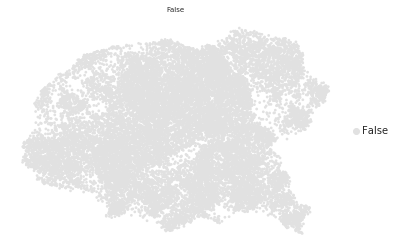

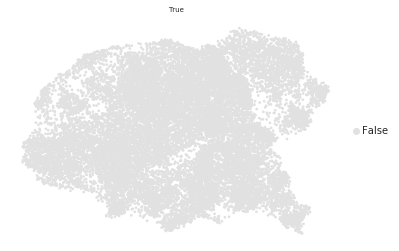

In [113]:
#create boolean list indicating membership to cluster(s) of interest
for v,j in enumerate(condition_to_highlight):
    clusters_highlight_bool = []
    color_map_highlight = [fade_color, highlight_color_list[v]]

    for i in adata_bool.obs.index:
        cluster_bool = adata_bool.obs.loc[i,:][condition_name] in j #loop over indices to assess whether cluster membership of each index is included in cluster memberships of interest
        clusters_highlight_bool.append(cluster_bool)
    
    #add new column to AnnData .obs element to indicate membership of cell index to cluster group of interest

    adata_bool.obs['cluster_of_interest'] = pd.Categorical(clusters_highlight_bool)
    
    #plot
    %matplotlib inline 
    sc.pl.umap(adata_bool, color = ['cluster_of_interest'],layer='imputed', s = 30, palette=color_map_highlight,legend_fontsize = 10, vmin=0, title= '-'.join(j))

## run palantir

# cluster distribution (crosstabs)

In [ ]:
#indicate adatas to be analyzed

adatas_names = ['TNK']
continue_with_adata = False
adata_path = '/data/peer/wallet/Jupyter/2020_Peer_PDAC_dev_Lowe/PDAC_dev_Lowe_final_samples_krasprog_shIL33_scran_TNK_scran_raw_element_obs_element_highlyvar_10000_clustered.h5ad'

pheno_k30_name = 'pheno_var_TNK_k20'
pheno_k10_name = 'pheno_var_TNK_k10'

In [ ]:
if continue_with_adata == False:
    adata = sc.read(adata_path)
    

In [ ]:
#define list of adatas
adatas = [adata]

## samples x clusters relative

In [ ]:
#calculate crosstabs
Tcell_frequencies_phenok10 = pd.crosstab(adata.obs[pheno_k10_name], adata.obs['sample_id']).apply(lambda r: r/r.sum(), axis=0)
Tcell_frequencies_pheno = pd.crosstab(adata.obs[pheno_k30_name], adata.obs['sample_id']).apply(lambda r: r/r.sum(), axis=0)

In [ ]:
TIL_frequency_subsets = [Tcell_frequencies_phenok10, Tcell_frequencies_pheno]

In [ ]:
#delete -1 from bars 

TIL_frequency_subsets_clean = []

for i in TIL_frequency_subsets:
    if -1 in i.index: #only applies -1 dropping to dataframes containing -1 cluster
        i = i.drop(-1, axis=0)
        TIL_frequency_subsets_clean.append(i)
    else:
        TIL_frequency_subsets_clean.append(i)

In [ ]:
for i,v in enumerate(TIL_frequency_subsets_clean):
    
    #calculate hierarchical clustering using wards method
    Z = hc.linkage(v.T, 'ward')
    a = hc.dendrogram(Z, leaf_rotation=90, leaf_font_size=8, labels=v.T.index, no_plot=True)
    
    #sort dataframe according to clustering results
    ordered_series = []
    for j in a['ivl']:
        series_by_index = v.T.loc[j]
        ordered_series.append(series_by_index)
    ordered_df = pd.concat(ordered_series, axis=1)
    
    #plot bars
    ordered_df.T.plot(kind='bar', stacked=True,
          figsize=(12,6), legend= False, cmap= color_map_clusters_plt)
    plt.legend(bbox_to_anchor=(0.5, 0.2, 1, 0.75))
    plt.title(subset_names_list[i])

In [ ]:
#save to csv
TIL_frequency_subsets_clean[0].to_csv('/data/peer/wallet/Jupyter/2020_Peer_PDAC_dev_Lowe/PDAC_dev_Lowe_TNK_final_samples_scran_clustered_crosstab_relative_frequencies_samplesxclusters_phenok10')
TIL_frequency_subsets_clean[1].to_csv('/data/peer/wallet/Jupyter/2020_Peer_PDAC_dev_Lowe/PDAC_dev_Lowe_TNK_final_samples_scran_clustered_crosstab_relative_frequencies_samplesxclusters_phenok30')


## samples x clusters absolute

In [ ]:
#create crosstabs with absolute cells per donor labeled by cluster\

#k30

cluster_absolute_k30 = []

for i in adatas:
    a = pd.crosstab(i.obs[pheno_k30_name], i.obs['sample_id'])
    cluster_absolute_k30.append(a)
    

In [ ]:
#k10
cluster_absolute_k10 = []

for i in adatas:
    a = pd.crosstab(i.obs[pheno_k10_name], i.obs['sample_id'])
    cluster_absolute_k10.append(a)

In [ ]:
#plot absolute cell numbers k10
%matplotlib inline
for i,v in enumerate(cluster_absolute_k10):
    v.T.plot(kind='bar', stacked=True,
          figsize=(12,6), legend= False, cmap=color_map_clusters_plt)
    plt.legend(bbox_to_anchor=(0.5, 0.2, 0.6, 0.5))
    plt.title(adatas_names[i]+' k10')


#plot absolute cell numbers k30
for i,v in enumerate(cluster_absolute_k30):
    v.T.plot(kind='bar', stacked=True,
          figsize=(12,6), legend= False, cmap=color_map_clusters_plt)
    plt.legend(bbox_to_anchor=(0.5, 0.2, 0.6, 0.5))
    plt.title(adatas_names[i]+' k30')
    



In [ ]:
#save to csv
cluster_absolute_k10[0].to_csv('/data/peer/wallet/Jupyter/2020_Peer_PDAC_dev_Lowe/PDAC_dev_Lowe_TNK_final_samples_scran_clustered_crosstab_absolute_frequencies_samplesxclusters_phenok10.csv')
cluster_absolute_k30[0].to_csv('/data/peer/wallet/Jupyter/2020_Peer_PDAC_dev_Lowe/PDAC_dev_Lowe_TNK_final_samples_scran_clustered_crosstab_absolute_frequencies_samplesxclusters_phenok30.csv')

## clusters x samples absolute

In [ ]:
#calculate crosstabs
Tcell_frequencies_phenok10 = pd.crosstab( adata.obs['sample_id'],adata.obs[pheno_k10_name]).apply(lambda r: r/r.sum(), axis=0)
Tcell_frequencies_pheno = pd.crosstab(adata.obs['sample_id'],adata.obs[pheno_k30_name]).apply(lambda r: r/r.sum(), axis=0)

In [ ]:
TIL_frequency_subsets = [Tcell_frequencies_phenok10, Tcell_frequencies_pheno]
subset_names_list = ['TNK_phenok10', 'TNK_phenok30']

In [ ]:
#delete -1 from bars 

TIL_frequency_subsets_clean = []

for i in TIL_frequency_subsets:
    if -1 in i.index: #only applies -1 dropping to dataframes containing -1 cluster
        i = i.drop(-1, axis=0)
        TIL_frequency_subsets_clean.append(i)
    else:
        TIL_frequency_subsets_clean.append(i)

In [ ]:
for i,v in enumerate(TIL_frequency_subsets_clean):
    v.T.plot(kind='bar', stacked=True,
          figsize=(12,6), legend= False, cmap=color_map_clusters_plt)
    plt.legend(bbox_to_anchor=(1, 0, 0.6, 1))
    plt.title(subset_names_list[i])

In [ ]:
#save to csv
TIL_frequency_subsets_clean[0].to_csv('/data/peer/wallet/Jupyter/2020_Peer_PDAC_dev_Lowe/PDAC_dev_Lowe_TNK_final_samples_scran_clustered_crosstab_relative_frequencies_clustersxsamples_phenok10.csv')
TIL_frequency_subsets_clean[1].to_csv('/data/peer/wallet/Jupyter/2020_Peer_PDAC_dev_Lowe/PDAC_dev_Lowe_TNK_final_samples_scran_clustered_crosstab_relative_frequencies_clustersxsamples_phenok30.csv')

# typing heatmaps

In [ ]:
#define adata, clusters and marker genes for heatmaps here
adata_typing_path = '/data/peer/wallet/Jupyter/2020_Peer_PDAC_dev_Lowe/PDAC_dev_Lowe_final_samples_krasprog_shIL33_scran_TNK_scran_raw_element_obs_element_clustered.h5ad'
pheno_heat = 'pheno_TNK_k20'
save_path_heat = '/data/peer/wallet/Jupyter/2020_Peer_PDAC_dev_Lowe/PDAC_dev_Lowe_final_samples_krasprog_shIL33_scran_TNK_scran_raw_element_obs_element_clustered_heatmap_zscored_cells.csv'
continue_with_adata = False

#define marker genes
load_marker_genes = False
marker_genes_path = '/data/peer/wallet/Jupyter/2020_Peer_PDAC_dev_Lowe/gene_sets/PDAC_Lowe_TILC_markers.csv' #path of marker gene csv file with gene column
gene_column_name = 'gene_name' #name of column in csv file where gene names are located

#define visualization parameters
layer_heat_imputed = True
z_score_cluster = False
cluster_minus_one_present = False #when PhenoGraph cannot put cells into a cluster it will label these cells with -1, if this is True these cells will not be plotted in the heatmaps
z_score_cells = True #if True gene expression will be z scored across cells and average z score per cluster will be calculated, if false average gene expression per cluster will be calculated and z scored across clusters

#dictionary containing major subtype identities
cluster_marker_dict_overlap = {'B':list(range(19)),'M':list(range(37))} #dictionary holding overlap gene sets

In [ ]:
#if needed custom marker genes

marker_genes_custom = ['ADD1',
'AIFM3',
'ANKH',
'ANXA1',
'APP',
'ATF3',
'AVPR1A',
'BAX',
'BCAP31',
'BCL10',
'BCL2L1',
'BCL2L10',
'BCL2L11',
'BCL2L2',
'BGN',
'BID',
'BIK',
'BIRC3',
'BMF',
'BMP2',
'BNIP3L',
'BRCA1',
'BTG2',
'BTG3',
'CASP1',
'CASP2',
'CASP3',
'CASP4',
'CASP6',
'CASP7',
'CASP8',
'CASP9',
'CAV1',
'CCNA1',
'CCND1',
'CCND2',
'CD14',
'CD2',
'CD38',
'CD44',
'CD69',
'CDC25B',
'CDK2',
'CDKN1A',
'CDKN1B',
'CFLAR',
'CLU',
'CREBBP',
'CTH',
'CTNNB1',
'CYLD',
'DAP',
'DAP3',
'DCN',
'DDIT3',
'DFFA',
'DIABLO',
'DNAJA1',
'DNAJC3',
'DNM1L',
'DPYD',
'EBP',
'EGR3',
'EMP1',
'ENO2',
'ERBB2',
'ERBB3',
'EREG',
'ETF1',
'F2',
'F2R',
'FAS',
'FASLG',
'FDXR',
'FEZ1',
'GADD45A',
'GADD45B',
'GCH1',
'GNA15',
'GPX1',
'GPX3',
'GPX4',
'GSN',
'GSR',
'GSTM1',
'GUCY2D',
'H1-0',
'HGF',
'HMGB2',
'HMOX1',
'HSPB1',
'IER3',
'IFITM3',
'IFNB1',
'IFNGR1',
'IGF2R',
'IGFBP6',
'IL18',
'IL1A',
'IL1B',
'IL6',
'IRF1',
'ISG20',
'JUN',
'KRT18',
'LEF1',
'LGALS3',
'LMNA',
'LUM',
'MADD',
'MCL1',
'MGMT',
'MMP2',
'NEDD9',
'NEFH',
'PAK1',
'PDCD4',
'PDGFRB',
'PEA15',
'PLAT',
'PLCB2',
'PLPPR4',
'PMAIP1',
'PPP2R5B',
'PPP3R1',
'PPT1',
'PRF1',
'PSEN1',
'PSEN2',
'PTK2',
'RARA',
'RELA',
'RETSAT',
'RHOB',
'RHOT2',
'RNASEL',
'ROCK1',
'SAT1',
'SATB1',
'SC5D',
'SLC20A1',
'SMAD7',
'SOD1',
'SOD2',
'SPTAN1',
'SQSTM1',
'TAP1',
'TGFB2',
'TGFBR3',
'TIMP1',
'TIMP2',
'TIMP3',
'TNF',
'TNFRSF12A',
'TNFSF10',
'TOP2A',
'TSPO',
'TXNIP',
'VDAC2',
'WEE1',
'XIAP']

In [ ]:
##### load marker genes

if load_marker_genes ==True:
    marker_genes_df = pd.read_csv(marker_genes_path)
    ##add additional genes of interest here
    interesting_genes= ['Il33','IL1RL1','CD44']
    #extract gene names and combine lists
    marker_genes = list(marker_genes_df.loc[:,gene_column_name])
    marker_genes = marker_genes + interesting_genes
    marker_genes = list(set(marker_genes))
else:
    marker_genes = list(set(marker_genes_custom))
        

In [ ]:
#load anndata
if continue_with_adata == False:
    adata = sc.read(adata_typing_path)
adata

In [ ]:
# Filter out genes not present in single cell data
marker_genes_filtered = []
for marker in marker_genes:
    if marker in adata.var.index:   
        marker_genes_filtered.append(marker)
    else:
        print(marker + ' filtered out')

In [ ]:
marker_genes_filtered

In [ ]:
if z_score_cells == False and z_score_cluster == False:
    
    ## calculate means for each cluster and export to dataframe
    all_cells_df_clean = adata.obs[pheno_heat] 
    clusters_cells_clean = list(set(all_cells_df_clean.values))
    
    ## remove -1 cells not belonging to any cluster
    if cluster_minus_one_present == True:
        clusters_cells_clean.remove(-1) #optional if -1 in heatmap
    
    ## create empty dataframe
    marker_df = pd.DataFrame(index=clusters_cells_clean, columns=marker_genes_filtered)
    marker_df = marker_df.astype('float') 
    
    ## select imputed or raw layer 
    if layer_heat_imputed == True:
        gene_expression_zscored = pd.DataFrame(
        adata.layers['imputed'], index=adata.obs_names, columns=adata.var_names)
    else:
        gene_expression_zscored = pd.DataFrame(
        adata.X, index=adata.obs_names, columns=adata.var_names)

    for i in clusters_cells_clean:
        print('Cluster: ',i)
        cluster_adata = all_cells_df_clean[all_cells_df_clean==i]
        cluster_adata2 = gene_expression_zscored.loc[cluster_adata.index, :]
        for j in marker_genes_filtered:
            marker_df.loc[i,:] = np.mean(cluster_adata2, axis=0)
            
    %matplotlib inline
    
    # drop na columns
    marker_df = marker_df.dropna(axis=1, how='any', thresh=None, subset=None, inplace=False)
    
    # drop all zero columns
    non_zero = (marker_df != 0).any(axis=0)
    marker_df = marker_df[non_zero.index[non_zero]]#drop zeros columns bc SD will be 0 --> cant divide with 0 for z score
    
    # set color scale
    divnorm = colors.DivergingNorm(vmin=-1, vcenter=0, vmax=1)
    marker_df = marker_df.astype(float) #  gene expression means x pheno cluster matrix
    sns.set(font_scale = 2) # if error matplotlib has no attribute DivergingNorm appears update Matplotlib
    sns.clustermap(marker_df, cmap='bwr', col_cluster=True, figsize=(50,10), vmax=3, z_score= False, norm=divnorm) # if error matplotlib has no attribute DivergingNorm appears update Matplotlib

In [ ]:
if z_score_cells == True and z_score_cluster == False:   
    
    ## calculate means for each cluster and export to dataframe
    all_cells_df_clean = adata.obs[pheno_heat] 
    clusters_cells_clean = list(set(all_cells_df_clean.values))
    
    ## remove -1 cells not belonging to any cluster
    if cluster_minus_one_present == True:
        clusters_cells_clean.remove(-1) #optional if -1 in heatmap
        
    ## create empty dataframe
    marker_df = pd.DataFrame(index=clusters_cells_clean, columns=marker_genes_filtered)
    marker_df = marker_df.astype('float')
 
    ## select imputed or raw layer   
    if layer_heat_imputed == True:
        gene_expression_zscored = pd.DataFrame(scipy.stats.zscore(adata.layers['imputed'],axis=0), index=adata.obs_names, columns=adata.var_names) # create zscored gene expression df
    else:
        gene_expression_zscored = pd.DataFrame(scipy.stats.zscore(adata.X, axis=0), index=adata.obs_names, columns=adata.var_names)
        
    for i in clusters_cells_clean:
        print('Cluster: ',i)
        cluster_adata = all_cells_df_clean[all_cells_df_clean==i]
        cluster_adata2 = gene_expression_zscored.loc[cluster_adata.index, :]
        for j in marker_genes_filtered:
            marker_df.loc[i,:] = np.mean(cluster_adata2, axis=0)

    %matplotlib inline

    # drop na columns
    marker_df = marker_df.dropna(axis=1, how='any', thresh=None, subset=None, inplace=False)

    # drop all zero columns
    non_zero = (marker_df != 0).any(axis=0)
    marker_df = marker_df[non_zero.index[non_zero]]#drop zeros columns bc SD will be 0 --> cant divide with 0 for z score

    # set color scale
    divnorm = colors.DivergingNorm(vmin=-2, vcenter=0, vmax=2)
    marker_df = marker_df.astype(float) #  gene expression means x pheno cluster matrix
    sns.set(font_scale = 2) # if error matplotlib has no attribute DivergingNorm appears update Matplotlib
    sns.clustermap(marker_df, cmap='bwr', col_cluster=True, figsize=(100,40), vmax=3, z_score=None, norm=divnorm) # if error matplotlib has no attribute DivergingNorm appears update Matplotlib

In [ ]:
if z_score_cluster ==True and z_score_cluster == False:
    ## calculate means for each cluster and export to dataframe
    all_cells_df_clean = adata.obs[pheno_heat] 
    clusters_cells_clean = list(set(all_cells_df_clean.values))
    
    ## remove -1 cells not belonging to any cluster
    if cluster_minus_one_present == True:
        clusters_cells_clean.remove(-1) #optional if -1 in heatmap
    
    ## create empty dataframe
    marker_df = pd.DataFrame(index=clusters_cells_clean, columns=marker_genes_filtered)
    marker_df = marker_df.astype('float') 
    
    ## select imputed or raw layer 
    if layer_heat_imputed == True:
        gene_expression_zscored = pd.DataFrame(
        adata.layers['imputed'], index=adata.obs_names, columns=adata.var_names)
    else:
        gene_expression_zscored = pd.DataFrame(
        adata.X, index=adata.obs_names, columns=adata.var_names)

    for i in clusters_cells_clean:
        print('Cluster: ',i)
        cluster_adata = all_cells_df_clean[all_cells_df_clean==i]
        cluster_adata2 = gene_expression_zscored.loc[cluster_adata.index, :]
        for j in marker_genes_filtered:
            marker_df.loc[i,:] = np.mean(cluster_adata2, axis=0)
            
    %matplotlib inline
    
    # drop na columns
    marker_df = marker_df.dropna(axis=1, how='any', thresh=None, subset=None, inplace=False)
    
    # drop all zero columns
    non_zero = (marker_df != 0).any(axis=0)
    marker_df = marker_df[non_zero.index[non_zero]]#drop zeros columns bc SD will be 0 --> cant divide with 0 for z score
    
    # set color scale
    divnorm = colors.DivergingNorm(vmin=-1, vcenter=0, vmax=1)
    marker_df = marker_df.astype(float) #  gene expression means x pheno cluster matrix
    sns.set(font_scale = 2) # if error matplotlib has no attribute DivergingNorm appears update Matplotlib
    sns.clustermap(marker_df, cmap='bwr', col_cluster=True, figsize=(50,10), vmax=3, z_score= 1, norm=divnorm) # if error matplotlib has no attribute DivergingNorm appears update Matplotlib

In [ ]:
#dotplot
%matplotlib inline
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, dendrogram=True, standard_scale='var')

In [ ]:
# save to csv
marker_df.to_csv(save_path_heat) # otherwise will write a first column with index 0

In [ ]:
adata

## highlight cluster of interest

In [ ]:
#higlight cluster of interest
condition_to_highlight = [[13,5,8,2,1,0,9,4],[7,3],[10],[15,14,6,11,12]]
condition_to_highlight_name = ['CD4','CD8','gdT','ILC']
condition_name = 'pheno_TNK_k30'
highlight_color_list = color_map_clusters
#data
adata_bool = adata

#colors
fade_color = '#e1e1e1'

In [ ]:
#create boolean list indicating membership to cluster(s) of interest
for v,j in enumerate(condition_to_highlight):
    clusters_highlight_bool = []
    color_map_highlight = [fade_color, highlight_color_list[v]]

    for i in adata_bool.obs.index:
        cluster_bool = adata_bool.obs.loc[i,:][condition_name] in j #loop over indices to assess whether cluster membership of each index is included in cluster memberships of interest
        clusters_highlight_bool.append(cluster_bool)
    
    #add new column to AnnData .obs element to indicate membership of cell index to cluster group of interest

    adata_bool.obs['cluster_of_interest'] = pd.Categorical(clusters_highlight_bool)
    
    #plot
    %matplotlib inline 
    sc.pl.umap(adata_bool, color = ['cluster_of_interest'],layer='imputed', s = 30, palette=color_map_highlight,legend_fontsize = 10, vmin=0, title= condition_to_highlight_name[v])

# thresholded heatmaps

## set parameters

In [ ]:
#chose parameters
save_path_marker = '/data/peer/wallet/Jupyter/2020_Peer_PDAC_dev_Lowe/PDAC_dev_Lowe_final_samples_krasprog_shIL33_scran_TNK_scran_raw_element_obs_element_clustered_phenok30_overlap.csv'
pheno_marker = 'pheno_TNK_k30'
adata_path = '/data/peer/wallet/Jupyter/2020_Peer_PDAC_dev_Lowe/PDAC_dev_Lowe_final_samples_krasprog_shIL33_scran_TNK_scran_raw_element_obs_element_clustered.h5ad'
continue_with_adata = True

In [ ]:
##gene sets
path_signatures = '/data/peer/wallet/Jupyter/2020_Peer_PDAC_dev_Lowe/gene_sets/overlap/' #path of marker gene csv file with gene column
path_signature_names_pos =  '_cell_manual_sig_positive_mouse_200927.csv'
path_signature_names_neg =  '_cell_manual_sig_negative_mouse_200927.csv'
path_cell_names = 'ILC'#indicate cell population of interest
suffix_pos = '_pos' #select positive typing markers for thresholded heatmap
suffix_neg = '_neg' #select positive typing markers for thresholded heatmap
pheno_marker = 'pheno_TNK_k10'

#genes of interest - indicate additional genes of interest here
genes_of_interest = []

In [ ]:
#dictionary containing major subtype identities
cluster_marker_dict_overlap = {'CD4':[13,5,8,2,1,0,9,4],'CD8':[7,3],'gdT':[7],
                               'ILC':[15,14,6,11,12]} #dictionary holding overlap gene sets

## calculate z-scored gene expression and threshold

In [ ]:
#load subset files
if continue_with_adata == False:
    adata = sc.read(adata_path)

In [ ]:
path_signatures+path_cell_names+path_signature_names_pos

In [ ]:
#load signatures
signatures_typing = {}
a = pd.read_csv(path_signatures+path_cell_names+path_signature_names_pos)
a_name = path_cell_names+suffix_pos
a_dict = sqlargs(a.to_dict(orient='list')) #sqlargs removes nan from dicts
signatures_typing[a_name]=a_dict
b = pd.read_csv(path_signatures+path_cell_names+path_signature_names_neg)
b_name = path_cell_names+suffix_neg
b_dict = sqlargs(b.to_dict(orient='list'))
signatures_typing[b_name]=b_dict

In [ ]:
#concatenate all typing markers from signature lists and 
typing_genes = []
for i in signatures_typing[path_cell_names+suffix_pos]:
    typing_genes = typing_genes + signatures_typing[path_cell_names+suffix_pos][i]
    
typing_genes = list(set(typing_genes)) + genes_of_interest
typing_genes

In [ ]:
# Filter out genes not present in single cell data
typing_genes_filtered = []
for marker in typing_genes:
    if marker in adata.var.index:   
        typing_genes_filtered.append(marker)
    else:
        print(marker + ' filtered out')

In [ ]:
## calculate means for each cluster and export to dataframe

all_cluster_df = adata.obs[pheno_marker] 

all_cluster_df_set = set(all_cluster_df)

markers_df = pd.DataFrame(index=cluster_marker_dict_overlap[path_cell_names], columns=typing_genes_filtered)

for i in cluster_marker_dict_overlap[path_cell_names]:
    print('Cluster: ',i)
    cluster_adata = all_cluster_df[all_cluster_df==i]
    cluster_adata2 = adata[cluster_adata.index, :]
    for j in typing_genes_filtered:
        markers_df.loc[i,j] = np.mean(cluster_adata2[:,j].X)

# to csv
markers_df.to_csv(save_path_marker) # otherwise will write a first column with index 0
markers_df

In [ ]:
#prepare dataframe for z scoring
from scipy.stats import zscore
markers_df_clean = pd.read_csv(save_path_marker, index_col=0) # otherwise will read a first column with index 0
markers_df_clean = markers_df_clean.dropna(axis=1) # dropnas bc doesnt work with clustermap
non_zero = (markers_df_clean != 0).any(axis=0)
markers_df_clean = markers_df_clean[non_zero.index[non_zero]]#drop zeros columns bc SD will be 0 --> cant divide with 0 for z score
typing_genes_filtered = markers_df_clean.columns.values #update gene list to account for genes dropped
markers_df_clean

In [ ]:
#zscore
markers_df_clean = pd.DataFrame((scipy.stats.zscore(
    markers_df_clean,
    axis=0)), columns= markers_df_clean.columns.values, index=cluster_marker_dict_overlap[path_cell_names])  # Across cells
markers_df_clean

In [ ]:
##loop over dataframe and assign threshold: here every value below 0.2 zscore will be -1

markers_df = pd.DataFrame(index=markers_df_clean.index.values, columns=markers_df_clean.columns.values)

#threshold for heatmap
for i in set(cluster_marker_dict_overlap[path_cell_names]):
    print('Cluster: ',i)
    for j in typing_genes_filtered:
        if markers_df_clean.loc[i,j]< 0.2:
                markers_df.loc[i,j] = -1
        else:
                markers_df.loc[i,j] = 1
                
markers_df = markers_df.astype('float')

In [ ]:
# set color scale
%matplotlib inline
sns.set(font_scale = 2) # if error matplotlib has no attribute DivergingNorm appears update Matplotlib
sns.clustermap(markers_df,linewidths=2, col_cluster=True, linecolor='black', cmap='bwr',cbar=False, figsize=(30,10)) # if error matplotlib has no attribute DivergingNorm appears update Matplotlib

# overlap signatures

In [ ]:
#define adata, clusters and marker genes for heatmaps here

##save paths
adata_path = '/data/peer/wallet/Jupyter/2020_Peer_PDAC_dev_Lowe/results/PDAC_dev_Lowe_TNK_re-scran_clustered_100PC_phenok10_overlap.csv'
save_path_overlap = '/data/peer/wallet/Jupyter/2020_Peer_PDAC_dev_Lowe/PDAC_dev_Lowe_TNK_re-scran_clustered_heatmap_overlap_imputed.csv'
continue_with_adata = True

##clustering
pheno_overlap = 'pheno_TNK_k10'

##gene sets
path_signatures = '/data/peer/wallet/Jupyter/2020_Peer_PDAC_dev_Lowe/gene_sets/overlap/' #path of marker gene csv file with gene column
path_signature_names_pos =  '_cell_manual_sig_positive_mouse_200927.csv'
path_signature_names_neg =  '_cell_manual_sig_negative_mouse_200927.csv'
path_cell_names = 'CD8'
suffix_pos = '_pos'
suffix_neg = '_neg'


In [ ]:
#load adata
if continue_with_adata == False:
    adata = sc.read(adata_path)

In [ ]:
#load signatures
signatures_typing = {}
a = pd.read_csv(path_signatures+path_cell_names+path_signature_names_pos)
a_name = path_cell_names+suffix_pos
a_dict = sqlargs(a.to_dict(orient='list')) #sqlargs removes nan from dicts
signatures_typing[a_name]=a_dict
b = pd.read_csv(path_signatures+path_cell_names+path_signature_names_neg)
b_name = path_cell_names+suffix_neg
b_dict = sqlargs(b.to_dict(orient='list'))
signatures_typing[b_name]=b_dict

In [ ]:
signatures_typing

## calculate overlap

In [ ]:
#choose marker genes for population of interest ['B','M','CD4','CD8','ILC']
marker_overlap = path_cell_names #key to extract relevant gene sets from dictionary holding overlap gene sets

#parameters for DEG 
gene_number = 1000

In [ ]:
#extract clusters corresponding to population of interest (e.g. CD4 T cell, ILC ...) 

#create boolean list to subset adata
bool_overlap_indices = []

for i in adata.obs[pheno_overlap]:
    if i in cluster_marker_dict_overlap[marker_overlap]:
        bool_overlap_indices.append(True)
    else:
        bool_overlap_indices.append(False)

adata_subset = adata[bool_overlap_indices]

In [ ]:
#calculate DEG
sc.tl.rank_genes_groups(adata_subset, pheno_overlap, groups='all', reference='rest', n_genes=gene_number, copy=False, method='wilcoxon', corr_method='benjamini-hochberg', layer=None)

In [ ]:
sc.pl.rank_genes_groups(adata_subset, n_genes=30)

In [ ]:
#calculate marker scores
marker_scores_pos = sc.tl.marker_gene_overlap(adata_subset, signatures_typing[marker_overlap+suffix_pos], method='overlap_coef')
marker_scores_neg = sc.tl.marker_gene_overlap(adata_subset, signatures_typing[marker_overlap+suffix_neg], method='overlap_coef')

In [ ]:
#plot heatmaps
%matplotlib inline
sns.set(font_scale = 2)
sns.clustermap(marker_scores_pos,cmap='bwr',row_cluster=False, col_cluster=False,z_score=1,vmin=-2,vmax=2)
sns.clustermap(marker_scores_neg,cmap='bwr_r',row_cluster=False, col_cluster=False,z_score=1,vmin=-2,vmax=2 )

# phenotypic volume

In [ ]:
from scipy.linalg import eigvalsh

In [ ]:
#define adata, clusters and marker genes for heatmaps here
adata_path = '/data/peer/wallet/Jupyter/2020_Peer_PDAC_dev_Lowe/PDAC_dev_Lowe_final_samples_krasprog_shIL33_scran_TNK_scran_raw_element_obs_element_clustered.h5ad'
pheno_heat = 'pheno_TNK_k20'
pheno_volume_csv_2b = '/data/peer/wallet/Jupyter/2020_Peer_PDAC_dev_Lowe/PDAC_dev_Lowe_final_samples_krasprog_shIL33_scran_TNK_scran_raw_element_obs_element_clustered_phenotypic_volume_without_replacement_all_samples.csv'
pheno_volume_csv_4 =  '/data/peer/wallet/Jupyter/2020_Peer_PDAC_dev_Lowe/PDAC_dev_Lowe_final_samples_krasprog_shIL33_scran_TNK_scran_raw_element_obs_element_clustered_phenotypic_volume_without_replacement_stages.csv'

In [ ]:
#map with stage dictionary
stage_dictionary = {'DACB528-CD45+': 'T4', 'DACD143-CD45+':'T5','DACD345_CD45_PLUS':'T5','DACD346-CD45+':'T4','DACD347_CD45_PLUS':'T5',
                   'DACD349_CD45_PLUS':'T5','DACD350-CD45+':'T4', 'DACD351-CD45+': 'T3', 'DACD404-CD45+':'T4','DACD406-CD45+':'T3',
                   'DACD407-CD45+':'T4_Day1','DACD408-CD45+':'T3','DACD482-CD45+':'T5'}

print('stage dictionary:')
print('length is:', len(set(stage_dictionary)))
print('includes:', set(stage_dictionary.values()))

In [ ]:
perturbation_dictionary = {'DACB528-CD45+': 'untreated', 'DACD143-CD45+':'untreated','DACD345_CD45_PLUS':'IL33KD','DACD346-CD45+':'IL33KD','DACD347_CD45_PLUS':'IL33KD',
                   'DACD349_CD45_PLUS':'untreated_control','DACD350-CD45+':'untreated_control', 'DACD351-CD45+': 'untreated_control', 'DACD404-CD45+':'untreated','DACD406-CD45+':'untreated',
                   'DACD407-CD45+':'untreated','DACD408-CD45+':'untreated','DACD482-CD45+':'untreated'}

print('perturbation dictionary:')
print('length is:', len(set(perturbation_dictionary)))
print('includes:', set(perturbation_dictionary.values()))

In [ ]:
adata = sc.read(adata_path)
print('loaded adata_path into adata')

In [ ]:
set(stage_dictionary.values())

In [ ]:
set(perturbation_dictionary.values())

In [ ]:
#retrieve different lists with different sample IDs of interest

i='T3'
b = adata[adata.obs['perturbation'].isin(['untreated','untreated_control'])]
T3_untreated = list(set(b[b.obs['stage']==i].obs['sample_id']))
T3_untreated

In [ ]:
#retrieve different lists with different sample IDs of interest

i='T4'
b = adata[adata.obs['perturbation'].isin(['untreated','untreated_control'])]
T4_untreated = list(set(b[b.obs['stage']==i].obs['sample_id']))
T4_untreated

In [ ]:
#retrieve different lists with different sample IDs of interest
i='T5'
b = adata[adata.obs['perturbation'].isin(['untreated','untreated_control'])]
T5_untreated = list(set(b[b.obs['stage']==i].obs['sample_id']))
T5_untreated

In [ ]:
adata.obs['sample_id'].value_counts()

In [ ]:
#bootstrap phenotypic volumes (without replacement)
n_iter = 20
smallest_sample = adata.obs['sample_id'].value_counts().sort_values(ascending=True).index[0]
print('smallest sample is:', smallest_sample, 'sampling', adata.obs['sample_id'].value_counts().sort_values(ascending=True)[0],'cells')
n_sampling = len(adata[adata.obs['sample_id']==smallest_sample])
replacement = False

#untreated samples
all_samples = list(set(adata.obs['sample_id']))

##initialize variables
counter = 0
pheno_vol_df_2b = pd.DataFrame(index=all_samples)

##bootstrap
while counter <n_iter:
    pheno_vol_samples = []
    for i in all_samples:
        adata = randomize_cells(adata)
        cov = np.cov(adata[adata[adata.obs['sample_id']==i].obs.sample(n=n_sampling, replace=replacement, random_state=1, axis=0).index,:].X.T)
        eigval = scipy.linalg.eigvalsh(cov)
        phenovolume = np.sum(np.log(eigval[~np.isclose(eigval,0)]))
        pheno_vol_samples.append(phenovolume)
    pheno_vol_df_2b[str(counter)]=pheno_vol_samples
    counter=counter+1
    print('finalized iteration number ',counter)

In [ ]:
pheno_vol_df_2b.to_csv(pheno_volume_csv_2b)
print('saved pheno_vol_df to:',pheno_volume_csv_2b)

In [ ]:
pheno_vol_df_2b

In [ ]:
adata[adata.obs['perturbation'].isin(['untreated','untreated_control'])].obs['stage'].value_counts()

In [ ]:
smallest_sample = adata[adata.obs['perturbation'].isin(['untreated','untreated_control'])].obs['stage'].value_counts().sort_values(ascending=True).index[0]
smallest_sample

In [ ]:
list(set(adata[adata.obs['perturbation'].isin(['untreated','untreated_control'])].obs['stage']))

In [ ]:
#bootstrap phenotypic volumes (without replacement)
n_iter = 20
smallest_sample = smallest_sample
adata_untreated = adata[adata.obs['perturbation'].isin(['untreated','untreated_control'])]
n_sampling = len(adata_untreated[adata_untreated.obs['stage']==smallest_sample])
smallest_sample = adata[adata.obs['perturbation'].isin(['untreated','untreated_control'])].obs['stage'].value_counts().sort_values(ascending=True).index[0]
print('smallest sample is:', smallest_sample, 'sampling', adata.obs['stage'].value_counts().sort_values(ascending=True).index[1],'cells')
replacement = False

#untreated samples
all_samples = list(set(adata_untreated.obs['stage']))


##initialize variables
counter = 0
pheno_vol_df_4 = pd.DataFrame(index=all_samples)

##bootstrap
while counter <n_iter:
    pheno_vol_samples = []
    for i in all_samples:
        adata_untreated = randomize_cells(adata_untreated)
        cov = np.cov(adata_untreated[adata_untreated[adata_untreated.obs['stage']==i].obs.sample(n=n_sampling, replace=replacement, random_state=1, axis=0).index,:].X.T)
        eigval = scipy.linalg.eigvalsh(cov)
        phenovolume = np.sum(np.log(eigval[~np.isclose(eigval,0)]))
        pheno_vol_samples.append(phenovolume)
    pheno_vol_df_4[str(counter)]=pheno_vol_samples
    counter=counter+1
    print('finalized iteration number ',counter)
pheno_vol_df_4.to_csv(pheno_volume_csv_4)
print('saved pheno_vol_df to:',pheno_volume_csv_4)
pheno_vol_df_4

In [ ]:
pheno_vol_df_4.to_csv(pheno_volume_csv_4)
print('saved pheno_vol_df to:',pheno_volume_csv_4)
pheno_vol_df_4

## plot phenovolume

In [ ]:
read_csv_path = '/data/peer/wallet/Jupyter/2020_Peer_PDAC_dev_Lowe/PDAC_dev_Lowe_final_samples_krasprog_shIL33_scran_TNK_scran_raw_element_obs_element_clustered_phenotypic_volume_without_replacement_all_samples.csv'

In [ ]:
#read data
pheno_vol_df = pd.read_csv(read_csv_path)
pheno_vol_df['stage'] = pheno_vol_df['Unnamed: 0'].map(stage_dictionary)
pheno_vol_df['treatment'] = pheno_vol_df['Unnamed: 0'].map(perturbation_dictionary)
pheno_vol_df

In [ ]:
pheno_vol_df = pheno_vol_df[pheno_vol_df['treatment'].isin(['untreated', 'untreated_control'])]

In [ ]:
#flatten dataframe to 
df_flat = pheno_vol_df
df_flat = pd.melt(df_flat, id_vars=['stage','treatment', 'Unnamed: 0'])
df_flat

In [ ]:
sns.set_theme(style="ticks")

f, ax = plt.subplots(figsize=(20,10))
ax.set_xlim(0,100)
ax.set_ylim(0,200)
sns.violinplot(x='stage', y='value', data=df_flat, order= ['T3','T4_Day1','T4','T5'], color = '#C4D4E3',  saturation=0.5)

sns.stripplot(x="stage", y="value", hue='Unnamed: 0', data=df_flat, dodge=False,  palette = color_map_clusters[10:20], alpha=0.5,  order= ['T3','T4_Day1','T4','T5']
             , size=10)

In [ ]:
#merge T4 and T4_Day1
dict_convert = {'T4':'T4','T5':'T5','T3':'T3','T4_Day1':'T4'}
df_flat['stage'] = df_flat['stage'].map(dict_convert)
sns.set_theme(style="ticks")

f, ax = plt.subplots(figsize=(20,10))
ax.set_xlim(0,100)
ax.set_ylim(0,200)


sns.violinplot(x='stage', y='value', data=df_flat, order= ['T3','T4','T5'], color = '#C4D4E3',  saturation=0.5)

sns.stripplot(x="stage", y="value", hue='Unnamed: 0', data=df_flat, dodge=False,  palette = color_map_clusters[10:20], alpha=0.5,  order= ['T3','T4','T5']
             , size=10)
plt.legend(loc='lower right')

In [ ]:
#calculate p value
pheno_vol_df = pheno_vol_df.set_index('Unnamed: 0')

In [ ]:
pheno_vol_df_mean = pd.DataFrame(pheno_vol_df.mean(axis=1))
pheno_vol_df_mean['stage'] = pheno_vol_df_mean.index.map(stage_dictionary)
pheno_vol_df_mean['stage'] = pheno_vol_df_mean['stage'].map(dict_convert)

In [ ]:
#define conditions to test
condition = 'stage'
condition_a = 'T4'
condition_b ='T5'
equal_variance = False

conditionA_means_array = np.array(pheno_vol_df_mean[pheno_vol_df_mean[condition]== condition_a][0])
conditionB_means_array = np.array(pheno_vol_df_mean[pheno_vol_df_mean[condition]==condition_b][0])
                                                    
scipy.stats.ttest_ind(conditionA_means_array, conditionB_means_array, equal_var=equal_variance)

In [ ]:
#read data
pheno_vol_df = pd.read_csv(read_csv_path)
pheno_vol_df['stage'] = pheno_vol_df['Unnamed: 0'].map(stage_dictionary)
pheno_vol_df['treatment'] = pheno_vol_df['Unnamed: 0'].map(perturbation_dictionary)
pheno_vol_df

In [ ]:
pheno_vol_df = pheno_vol_df[pheno_vol_df['treatment'].isin(['untreated_control','IL33KD'])]

In [ ]:
pheno_vol_df

In [ ]:
#flatten dataframe to 
df_flat = pheno_vol_df
df_flat = pd.melt(df_flat, id_vars=['stage','treatment', 'Unnamed: 0'])
df_flat['stage_treat']= df_flat['stage'] + ['_']*len(df_flat.index) + df_flat['treatment']
df_flat

In [ ]:
set(df_flat['stage_treat'])

In [ ]:
sns.set_theme(style="ticks")

f, ax = plt.subplots(figsize=(20,10))
ax.set_xlim(0,100)
ax.set_ylim(0,200)

sns.violinplot(x='stage_treat', y='value', data=df_flat, order= ['T3_untreated_control','T4_untreated_control','T5_untreated_control','T4_IL33KD','T5_IL33KD'], color = '#C4D4E3',  saturation=0.5)

sns.stripplot(x="stage_treat", y="value", hue='Unnamed: 0', data=df_flat, dodge=False,  palette = color_map_clusters, alpha=0.5,  order= ['T3_untreated_control','T4_untreated_control','T5_untreated_control','T4_IL33KD','T5_IL33KD']
             , size=10)
plt.legend(loc='lower right')

# correlation heatmaps

In [ ]:
#define adata, clusters and marker genes for heatmaps here
adata_typing_path = '/data/peer/wallet/Jupyter/2020_Peer_PDAC_dev_Lowe/PDAC_dev_Lowe_final_samples_krasprog_shIL33_scran_TNK_scran_raw_element_obs_element_clustered.h5ad'

#define marker genes
marker_genes_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/immune_marker_panel_clean_210216.csv' #path of marker gene csv file with gene column
gene_column_name = 'gene_name' #name of column in csv file where gene names are located

#define visualization parameters
layer_heat_imputed = True
#if false spearman coefficient will be calculated
calculate_covariance = True

#plot samples individually?
plot_samples = False
#samples_of_interest = ['DACD408-CD45+','DACD406-CD45+','DACD351-CD45+']
#samples_of_interest = ['DACD404-CD45+','DACD407-CD45+','DACB528-CD45+','DACD350-CD45+',]
samples_of_interest = ['DACD143-CD45+','DACD482-CD45+','DACD349_CD45_PLUS']
#plot samples of interest together?

In [ ]:
##### load marker genes

marker_genes_df = pd.read_csv(marker_genes_path, encoding='latin-1')
##add additional genes of interest here
interesting_genes= [] 

In [ ]:
#select mouse cytokine genes

marker_genes_df = marker_genes_df[marker_genes_df['species']=='mus_musculus']
marker_genes_df_cytokines = marker_genes_df[marker_genes_df['cytokine']==True]
marker_genes_df_receptors = marker_genes_df[marker_genes_df['cytokine_receptor']==True]

In [ ]:
#merge dfs
marker_genes_df = pd.concat([marker_genes_df_cytokines, marker_genes_df_receptors])

In [ ]:
#extract gene names and combine lists
marker_genes = list(marker_genes_df.loc[:,gene_column_name])
marker_genes = marker_genes + interesting_genes

## select sample

In [ ]:
#load anndata
adata_allsamples = sc.read(adata_typing_path)
adata_allsamples

In [ ]:
sample_ids = list(set(adata_allsamples.obs['sample_id']))

## plot

In [ ]:
sns.set(font_scale=1)

if plot_samples == True:
    for i  in sample_ids:
        adata = adata_allsamples[adata_allsamples.obs['sample_id']==i]
        # Filter out genes not present in single cell data
        marker_genes_filtered = []
        for marker in marker_genes:
            if marker in adata.var.index:   
                marker_genes_filtered.append(marker)

        # Filter out genes not present in single cell data
        a = np.std(adata[:,adata.var_names.isin(marker_genes_filtered)].X, axis=0)
        b = pd.DataFrame(a.T, index=adata[:,adata.var_names.isin(marker_genes_filtered)].var_names)
        c = b[0]!=0
        d = b[c]
        e = b[0]==0
        f = b[e]
        marker_genes_filtered_nonzeroSD = d

        #marker gene list
        marker_genes_filtered_nonzeroSD = list(marker_genes_filtered_nonzeroSD.index)
        
        #compute either covariance or corr coefficient
        
        if layer_heat_imputed == True:
            if calculate_covariance ==False:
                subsetcluster_cov = np.corrcoef(adata[:,marker_genes_filtered_nonzeroSD].layers['imputed'].T)
            else:
                subsetcluster_cov = np.cov(adata[:,marker_genes_filtered_nonzeroSD].layers['imputed'].T)
        else:
            if calculate_covariance ==False:
                subsetcluster_cov = np.corrcoef(adata[:,marker_genes_filtered_nonzeroSD].X.T)
            else:
                subsetcluster_cov = np.cov(adata[:,marker_genes_filtered_nonzeroSD].X.T)
        
        subsetcluster_cov_df = pd.DataFrame(subsetcluster_cov, index=marker_genes_filtered_nonzeroSD, columns=marker_genes_filtered_nonzeroSD)
        if True not in np.isnan(subsetcluster_cov):
            sns.clustermap(subsetcluster_cov_df,
                                         cmap='seismic',
                                         vmax=.4,
                                         center=0,
                                         vmin=-.4, figsize=(50, 50))
            path_csv = save_path_heat+i+'.csv'
            subsetcluster_cov_df.to_csv(path_csv)
            print('saved to:', path_csv)
            plt.show()
else:  
    adata = adata_allsamples[adata_allsamples.obs['sample_id'].isin(samples_of_interest)]
    # Filter out genes not present in single cell data
    marker_genes_filtered = []
    for marker in marker_genes:
        if marker in adata.var.index:   
            marker_genes_filtered.append(marker)

    # Filter out genes not present in single cell data
    a = np.std(adata[:,adata.var_names.isin(marker_genes_filtered)].X, axis=0)
    b = pd.DataFrame(a.T, index=adata[:,adata.var_names.isin(marker_genes_filtered)].var_names)
    c = b[0]!=0
    d = b[c]
    e = b[0]==0
    f = b[e]
    marker_genes_filtered_nonzeroSD = d

    #marker gene list
    marker_genes_filtered_nonzeroSD = list(marker_genes_filtered_nonzeroSD.index)
    
    #calculate covariance or corrcoef either on imputed or non imputed data:
    if layer_heat_imputed == True:
            if calculate_covariance ==False:             
                subsetcluster_cov = np.corrcoef(adata[:,marker_genes_filtered_nonzeroSD].layers['imputed'].T)
            else:             
                subsetcluster_cov = np.cov(adata[:,marker_genes_filtered_nonzeroSD].layers['imputed'].T)
                
    else:
            if calculate_covariance ==False:             
                subsetcluster_cov = np.corrcoef(adata[:,marker_genes_filtered_nonzeroSD].X.T)
            else:             
                subsetcluster_cov = np.cov(adata[:,marker_genes_filtered_nonzeroSD].X.T)
    subsetcluster_cov_df = pd.DataFrame(subsetcluster_cov, index=marker_genes_filtered_nonzeroSD, columns=marker_genes_filtered_nonzeroSD)
    
    
    if True not in np.isnan(subsetcluster_cov):
        tmp = sns.clustermap(subsetcluster_cov_df,
                                     cmap='seismic',
                                     vmax=0.2,
                                     center=0,
                                     vmin=-0.2, figsize=(50, 50))
        plt.show()

### this code copies the order of the last clustermap plotted

In [ ]:
#extract order of hierarchically clustered genes in clustermap
index_list = []

for i in list(tmp.dendrogram_row.reordered_ind):
    a = subsetcluster_cov_df.columns[i]
    index_list.append(a)

In [ ]:
subsetcluster_cov_df_2 = subsetcluster_cov_df.reindex(index_list, axis=0)
subsetcluster_cov_df_2 = subsetcluster_cov_df_2.reindex(index_list, axis=1)
subsetcluster_cov_df_2

In [ ]:
marker_genes_filtered_nonzeroSD

##  gene order is now specified, indicate samples to plot

In [ ]:
print(set(adata_allsamples.obs['sample_id']))

In [ ]:
#samples_of_interest = ['DACD408-CD45+','DACD406-CD45+','DACD351-CD45+']
#samples_of_interest = ['DACD404-CD45+','DACD407-CD45+','DACB528-CD45+','DACD350-CD45+',]
#samples_of_interest = ['DACD143-CD45+','DACD482-CD45+','DACD349_CD45_PLUS']
#samples_of_interest = ['DACD345_CD45_PLUS','DACD347_CD45_PLUS']

In [ ]:
#check if samples of interest are in adata
print('samples found in adata object')
print(list(set(adata_allsamples.obs['sample_id']).intersection(samples_of_interest)))
print('all samples of interest found in adata object')
print(set(adata_allsamples.obs['sample_id']).intersection(samples_of_interest) == set(samples_of_interest))

### plot heatmap with index order define according to last clustermap (perhaps adjust this code to have one gene list for all heatmaps)

In [ ]:
plt.subplots(figsize=(50,50))
adata = adata_allsamples[adata_allsamples.obs['sample_id'].isin(samples_of_interest)]
# Filter out genes not present in single cell data
marker_genes_filtered = []
for marker in marker_genes:
    if marker in adata.var.index:   
        marker_genes_filtered.append(marker)

# Filter out genes not present in single cell data
a = np.std(adata[:,adata.var_names.isin(marker_genes_filtered)].X, axis=0)
b = pd.DataFrame(a.T, index=adata[:,adata.var_names.isin(marker_genes_filtered)].var_names)
c = b[0]!=0
d = b[c]
e = b[0]==0
f = b[e]
marker_genes_filtered_nonzeroSD = d
#intersect genes != NaN != SD 0 with gene list they should be reordered to
marker_genes_filtered_nonzeroSD = list(subsetcluster_cov_df_2.index.intersection(marker_genes_filtered_nonzeroSD.index))

#intersect new index with genes expressed and SD !=0

#marker gene list
if layer_heat_imputed ==True:
    if calculate_covariance == False:
        subsetcluster_cov = np.corrcoef(adata[:,marker_genes_filtered_nonzeroSD].layers['imputed'].T)
    else:
        subsetcluster_cov = np.cov(adata[:,marker_genes_filtered_nonzeroSD].layers['imputed'].T)
else:
    if calculate_covariance == False:
        subsetcluster_cov = np.corrcoef(adata[:,marker_genes_filtered_nonzeroSD].X.T)
    else:
        subsetcluster_cov = np.cov(adata[:,marker_genes_filtered_nonzeroSD].X.T)

    
subsetcluster_cov_df = pd.DataFrame(subsetcluster_cov, index=marker_genes_filtered_nonzeroSD, columns=marker_genes_filtered_nonzeroSD)
if True not in np.isnan(subsetcluster_cov):
    tmp = sns.heatmap(subsetcluster_cov_df,
                                 cmap='seismic',
                                 vmax=0.1,
                                 center=0,
                                 vmin=-0.1)
    plt.show()

In [ ]:
#were sample IDs of interest plotted?
set(adata.obs['sample_id'])

# scCODA

In [ ]:
import warnings
warnings.filterwarnings("ignore")
import pickle as pkl

from sccoda.util import comp_ana as mod
from sccoda.util import cell_composition_data as dat
from sccoda.util import data_visualization as viz

In [ ]:
#paths
adata_typing_path = '/data/peer/wallet/Jupyter/2020_Peer_PDAC_dev_Lowe/PDAC_dev_Lowe_final_samples_krasprog_shIL33_scran_TNK_scran_raw_element_obs_element_clustered.h5ad'
pheno_test = 'pheno_TNK_k20'
sample_key = 'sample_id'
subset_key = 'perturbation'
subset_list = ['untreated','untreated_control']

#map with stage dictionary
covariate_dictionary = {'DACB528-CD45+': 'T4_untreated', 'DACD143-CD45+':'T5_untreated','DACD345_CD45_PLUS':'T5_IL33KD','DACD346-CD45+':'T4_IL33KD','DACD347_CD45_PLUS':'T5_IL33KD',
                   'DACD349_CD45_PLUS':'T5_untreated','DACD350-CD45+':'T4_untreated', 'DACD351-CD45+': 'T3_untreated', 'DACD404-CD45+':'T4_untreated','DACD406-CD45+':'T3_untreated',
                   'DACD407-CD45+':'T4_untreated','DACD408-CD45+':'T3_untreated','DACD482-CD45+':'T5_untreated'}

In [ ]:
#load data
adata = sc.read(adata_typing_path)
adata

In [ ]:
adata.obs[subset_key]

In [ ]:
#subset to untreated only

adata = adata[adata.obs[subset_key].isin(subset_list)]

## prepate dataframe

In [ ]:
#convert to sccoda compatible adata element

sccoda_df = pd.DataFrame(index= list(set(adata.obs[sample_key])), columns=list(set(adata.obs[pheno_test])))

for i in set(adata.obs[sample_key]):
    adata_subset = adata[adata.obs[sample_key]==i]
    sccoda_df.loc[i,:]= adata_subset.obs[pheno_test].value_counts()
sccoda_df

In [ ]:
#convert NaN to 0s

sccoda_df = sccoda_df.fillna(value=0)
sccoda_df

In [ ]:
#add index as column
sccoda_df = sccoda_df.astype(float)
sccoda_df = sccoda_df.reset_index()

In [ ]:
# Convert data to anndata object
data_all = dat.from_pandas(sccoda_df, covariate_columns=['index'])

# Extract condition from mouse name and add it as an extra column to the covariates
data_all.obs["Condition"] = data_all.obs['index'].map(covariate_dictionary)
print(data_all)

In [ ]:
set(data_all.obs["Condition"])

In [ ]:
data_all.obs['Condition']

In [ ]:
# Select control and test data
data_test = data_all[data_all.obs["Condition"].isin(['T3_untreated', 'T4_untreated', 'T5_untreated'])]
print(data_test.obs)

In [ ]:
data_test.obs

In [ ]:
data_test.X

In [ ]:
#sort values to change order of group bars in the bargrap
#mind that if you perform pandas .sort_values directly on AnnData.obs it will not change the order of AnnData.X
#therefore we will copy the index of our sorted .obs element and reorder .X accordingly
data_test_index = data_test.obs.sort_values(by='Condition',ascending=True, inplace=False).index.astype(int)
data_test.X = data_test.X[data_test_index]
data_test.obs = data_test.obs.reindex(list(data_test_index.map(str)))

In [ ]:
data_test.obs

In [ ]:
data_test.X

In [ ]:
viz.boxplots(data_test, feature_name="Condition",figsize=(20,5),cmap=stage_map_2, add_dots=True)

In [ ]:
#The reference_cell_type parameter is used to specify a cell type that is believed to be unchanged by the covariates in formula. 
#This is necessary, because compositional analysis must always be performed relative to a reference (See Büttner, Ostner et al., 2020 for a more thorough explanation). 
#took cluster 15 t cell here

model_stage = mod.CompositionalAnalysis(data_test, formula="Condition", reference_cell_type=15)

In [ ]:
# Run MCMC
sim_results = model_stage.sample_hmc()

In [ ]:
sim_results.summary()

In [ ]:
print(sim_results.credible_effects())

## compare perturbed/non perturbed

In [ ]:


#paths
adata_typing_path = '/data/peer/wallet/Jupyter/2020_Peer_PDAC_dev_Lowe/PDAC_dev_Lowe_final_samples_krasprog_shIL33_scran_TNK_scran_raw_element_obs_element_clustered.h5ad'
pheno_test = 'pheno_TNK_k20'
sample_key = 'sample_id'
subset_key = 'perturbation'
#subset_list = ['T4_untreated','T5_untreated','T4_IL33KD','T5_IL33KD']
subset_list = ['untreated','IL33KD']

#map with stage dictionary
#covariate_dictionary = {'DACB528-CD45+': 'T4_untreated', 'DACD143-CD45+':'T5_untreated','DACD345_CD45_PLUS':'T5_IL33KD','DACD346-CD45+':'T4_IL33KD','DACD347_CD45_PLUS':'T5_IL33KD',
#                   'DACD349_CD45_PLUS':'T5_untreated','DACD350-CD45+':'T4_untreated', 'DACD351-CD45+': 'T3_untreated', 'DACD404-CD45+':'T4_untreated','DACD406-CD45+':'T3_untreated',
#                   'DACD407-CD45+':'T4_untreated','DACD408-CD45+':'T3_untreated','DACD482-CD45+':'T5_untreated'}
covariate_dictionary = {'DACB528-CD45+': 'untreated', 'DACD143-CD45+':'untreated','DACD345_CD45_PLUS':'IL33KD','DACD346-CD45+':'IL33KD','DACD347_CD45_PLUS':'IL33KD',
                   'DACD349_CD45_PLUS':'untreated','DACD350-CD45+':'untreated', 'DACD351-CD45+': 'T3_untreated', 'DACD404-CD45+':'untreated','DACD406-CD45+':'T3_untreated',
                   'DACD407-CD45+':'untreated','DACD408-CD45+':'T3_untreated','DACD482-CD45+':'untreated'}

In [ ]:
#load data
adata = sc.read(adata_typing_path)
adata

In [ ]:
adata.obs[subset_key] = adata.obs[sample_key].map(covariate_dictionary)

In [ ]:
#subset to untreated only

adata = adata[adata.obs[subset_key].isin(subset_list)]
adata

### prepate dataframe

In [ ]:
#convert to sccoda compatible adata element

sccoda_df = pd.DataFrame(index= list(set(adata.obs[sample_key])), columns=list(set(adata.obs[pheno_test])))

for i in set(adata.obs[sample_key]):
    adata_subset = adata[adata.obs[sample_key]==i]
    sccoda_df.loc[i,:]= adata_subset.obs[pheno_test].value_counts()
sccoda_df

In [ ]:
#convert NaN to 0s

sccoda_df_filled = sccoda_df.fillna(value=0)
sccoda_df_filled

In [ ]:
#add index as column
sccoda_df_filled = sccoda_df_filled.astype(float)
sccoda_df_filled = sccoda_df_filled.reset_index()

In [ ]:
# Convert 0 filled data to anndata object
data_all_filled = dat.from_pandas(sccoda_df_filled, covariate_columns=['index'])

# Extract condition from mouse name and add it as an extra column to the covariates
data_all_filled.obs["Condition"] = data_all_filled.obs['index'].map(covariate_dictionary)
print(data_all_filled)

In [ ]:
set(data_all_filled.obs["Condition"])

In [ ]:
# Select control and test data
data_test = data_all_filled[data_all_filled.obs["Condition"].isin(list(set(data_all_filled.obs["Condition"])))]
print(data_test.obs)

In [ ]:
data_test.obs

In [ ]:
data_test.X

In [ ]:
#sort values to change order of group bars in the bargrap
#mind that if you perform pandas .sort_values directly on AnnData.obs it will not change the order of AnnData.X
#therefore we will copy the index of our sorted .obs element and reorder .X accordingly
data_test_index = data_test.obs.sort_values(by='Condition',ascending=False, inplace=False).index.astype(int)
data_test.X = data_test.X[data_test_index]
data_test.obs = data_test.obs.reindex(list(data_test_index.map(str)))

In [ ]:
data_test.obs

In [ ]:
data_test.X

In [ ]:
viz.boxplots(data_test, feature_name="Condition",figsize=(20,5),cmap=blue_red, add_dots=True)

In [ ]:
#The reference_cell_type parameter is used to specify a cell type that is believed to be unchanged by the covariates in formula. 
#This is necessary, because compositional analysis must always be performed relative to a reference (See Büttner, Ostner et al., 2020 for a more thorough explanation). 
#took cluster 15 t cell here

model_stage = mod.CompositionalAnalysis(data_test, formula="Condition", reference_cell_type=15)

In [ ]:
# Run MCMC
sim_results = model_stage.sample_hmc()

In [ ]:
sim_results.summary()

In [ ]:
print(sim_results.credible_effects())

# Annotate cells

In [ ]:
#define adata, clusters and marker genes for heatmaps here
adata_path = '/data/peer/wallet/Jupyter/2020_Peer_PDAC_dev_Lowe/PDAC_dev_Lowe_TNK_re-scran_clustered.h5ad'
adata_save_path = '/data/peer/wallet/Jupyter/2020_Peer_PDAC_dev_Lowe/PDAC_dev_Lowe_TNK_re-scran_clustered_annotated.h5ad'
pheno_annotate = 'pheno_k10_subset'
continue_with_adata = False

In [ ]:
if continue_with_adata == False:
    adata = sc.read(adata_path)

In [ ]:
adata.obs['pheno_TNK_k10']

In [ ]:
#create unique subset cluster names to later merge with in one .obs column with the other subsets (B, M..)
pheno_k10_subset_list = [i+j for i,j in zip(len(adata.obs['pheno_TNK_k10'])*['TNK_'], list(map(str, adata.obs['pheno_TNK_k10'])))]

In [ ]:
#add to .obs element
adata.obs[pheno_annotate] = pheno_k10_subset_list

In [ ]:
#mappings

##subtype_1

subtype_1_dict = {'TNK_-1':'NaN',
                 'TNK_0':'T',
                'TNK_1':'T',
                'TNK_2':'T',
                'TNK_3':'T',
                'TNK_4':'T',
                 'TNK_5':'T',
                 'TNK_6':'T',
                 'TNK_7':'T',
                 'TNK_8':'T',
                 'TNK_9':'T',
                 'TNK_10':'ILC',
                 'TNK_11':'T',
                 'TNK_12':'T',
                 'TNK_13':'ILC',
                 'TNK_14':'ILC',
                 'TNK_15':'ILC',
                 'TNK_16':'T',
                 'TNK_17':'ILC',
                 'TNK_18':'T',
                 'TNK_19':'ILC',
                 'TNK_20':'ILC',
                 'TNK_21':'T',
                 'TNK_22':'T',
                 'TNK_23':'T',
                 'TNK_24':'T',
                 'TNK_25':'T',
                 'TNK_26':'ILC',
                 'TNK_27':'ILC',
                 'TNK_28':'T',
                 'TNK_29':'ILC',
                 'TNK_30':'ILC'}

subtype_2_dict = {'TNK_-1':'NaN',
                 'TNK_0':'CD4_T',
                'TNK_1':'CD4_T',
                'TNK_2':'CD4_T',
                'TNK_3':'CD4_T',
                'TNK_4':'CD4_T',
                 'TNK_5':'CD4_T',
                 'TNK_6':'CD4_T',
                 'TNK_7':'gd_T',
                 'TNK_8':'CD8_T',
                 'TNK_9':'CD4_T',
                 'TNK_10':'ILC_2',
                 'TNK_11':'CD4_T',
                 'TNK_12':'CD4_T',
                 'TNK_13':'ILC_other',
                 'TNK_14':'NK',
                 'TNK_15':'ILC_2',
                 'TNK_16':'CD8_T',
                 'TNK_17':'ILC_2',
                 'TNK_18':'CD4_T',
                 'TNK_19':'NK',
                 'TNK_20':'ILC_3_LTi',
                 'TNK_21':'CD4_T',
                 'TNK_22':'CD4_T',
                 'TNK_23':'CD4_T',
                 'TNK_24':'CD8_T',
                 'TNK_25':'CD4_T',
                 'TNK_26':'NK',
                 'TNK_27':'ILC_2',
                 'TNK_28':'CD8_T',
                 'TNK_29':'ILC_2',
                 'TNK_30':'ILC_2'}

#subtype_3_dict = 

In [ ]:
#map with dictionary

adata.obs['subtype_1'] = adata.obs[pheno_annotate].map(subtype_1_dict)
adata.obs['subtype_2'] = adata.obs[pheno_annotate].map(subtype_2_dict)

In [ ]:
set(adata.obs['subtype_1'])

In [ ]:
set(adata.obs['subtype_2'])

In [ ]:
adata.write(adata_save_path)
print('AnnData object saved to:', adata_save_path)

## highlight cluster of interest

In [ ]:
#create list of list with sample ids to execute code below     
                  
condition_to_highlight = [['TNK_-1'],['TNK_0'],['TNK_1'],['TNK_2'],['TNK_3'],['TNK_4'],['TNK_5'],['TNK_6'],['TNK_7'],['TNK_8'],['TNK_9'],['TNK_10'],
                         ['TNK_11'],['TNK_12'],['TNK_13'],['TNK_14'],['TNK_15'],['TNK_16'],['TNK_17'],['TNK_18'],['TNK_19'],['TNK_20'],['TNK_21'],
                         ['TNK_22'],['TNK_23'],['TNK_24'],['TNK_25'],['TNK_26'],['TNK_27'],['TNK_28'],['TNK_29'],['TNK_30']]

#higlight cluster of interest
condition_name = 'pheno_k10_subset'
highlight_color_list = '#FF4A46'

#colors
fade_color = '#e1e1e1'

In [ ]:
#create boolean list indicating membership to cluster(s) of interest
for v,j in enumerate(condition_to_highlight):
    clusters_highlight_bool = []
    color_map_highlight = [fade_color, highlight_color_list]

    for i in adata.obs.index:
        cluster_bool = adata.obs.loc[i,:][condition_name] in j #loop over indices to assess whether cluster membership of each index is included in cluster memberships of interest
        clusters_highlight_bool.append(cluster_bool)
    
    #add new column to AnnData .obs element to indicate membership of cell index to cluster group of interest

    adata.obs['cluster_of_interest'] = pd.Categorical(clusters_highlight_bool)
    
    #plot
    %matplotlib inline 
    sc.pl.umap(adata, color = ['cluster_of_interest'],layer='imputed', s = 30, palette=color_map_highlight,legend_fontsize = 10, vmin=0, title= j)